<a href="https://colab.research.google.com/github/AlexisL321/Group18_CS539/blob/main/LSTM_stockPrediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas
import numpy as np
%matplotlib inline
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.dates as mandates
from sklearn.model_selection import TimeSeriesSplit
from sklearn.preprocessing import MinMaxScaler, LabelEncoder
from sklearn.metrics import mean_squared_error, r2_score
from sklearn import linear_model
from keras.layers import LSTM, Dense, Dropout
from keras.models import Sequential, load_model
from keras.callbacks import EarlyStopping
from tensorflow.keras.optimizers import Adam
from keras.layers import LSTM
from keras.utils.vis_utils import plot_model
import keras.backend as K
import datetime

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [ ]:
StockChoices=['ABT','ABBV','ACN','ATVI','AYI','ADBE','AMD','AAP','AES','AET',
		'AMG','AFL','A','APD','AKAM','ALK','ALB','ARE','ALXN','ALGN','ALLE',
		'AGN','ADS','LNT','ALL','GOOGL','GOOG','MO','AMZN','AEE','AAL','AEP',
		'AXP','AIG','AMT','AWK','AMP','ABC','AME','AMGN','APH','APC','ADI','ANDV',
		'ANSS','ANTM','AON','AOS','APA','AIV','AAPL','AMAT','APTV','ADM','ARNC',
		'AJG','AIZ','T','ADSK','ADP','AZO','AVB','AVY','BHGE','BLL','BAC','BK',
		'BAX','BBT','BDX','BRK.B','BBY','BIIB','BLK','HRB','BA','BWA','BXP','BSX',
		'BHF','BMY','AVGO','BF.B','CHRW','CA','COG','CDNS','CPB','COF','CAH','CBOE',
		'KMX','CCL','CAT','CBG','CBS','CELG','CNC','CNP','CTL','CERN','CF','SCHW',
		'CHTR','CHK','CVX','CMG','CB','CHD','CI','XEC','CINF','CTAS','CSCO','C','CFG',
		'CTXS','CLX','CME','CMS','KO','CTSH','CL','CMCSA','CMA','CAG','CXO','COP',
		'ED','STZ','COO','GLW','COST','COTY','CCI','CSRA','CSX','CMI','CVS','DHI',
		'DHR','DRI','DVA','DE','DAL','XRAY','DVN','DLR','DFS','DISCA','DISCK','DISH',
		'DG','DLTR','D','DOV','DWDP','DPS','DTE','DRE','DUK','DXC','ETFC','EMN','ETN',
		'EBAY','ECL','EIX','EW','EA','EMR','ETR','EVHC','EOG','EQT','EFX','EQIX','EQR',
		'ESS','EL','ES','RE','EXC','EXPE','EXPD','ESRX','EXR','XOM','FFIV','FB','FAST',
		'FRT','FDX','FIS','FITB','FE','FISV','FLIR','FLS','FLR','FMC','FL','F','FTV',
		'FBHS','BEN','FCX','GPS','GRMN','IT','GD','GE','GGP','GIS','GM','GPC','GILD',
		'GPN','GS','GT','GWW','HAL','HBI','HOG','HRS','HIG','HAS','HCA','HCP','HP','HSIC',
		'HSY','HES','HPE','HLT','HOLX','HD','HON','HRL','HST','HPQ','HUM','HBAN','HII',
		'IDXX','INFO','ITW','ILMN','IR','INTC','ICE','IBM','INCY','IP','IPG','IFF','INTU',
		'ISRG','IVZ','IQV','IRM','JEC','JBHT','SJM','JNJ','JCI','JPM','JNPR','KSU','K','KEY',
		'KMB','KIM','KMI','KLAC','KSS','KHC','KR','LB','LLL','LH','LRCX','LEG','LEN','LUK',
		'LLY','LNC','LKQ','LMT','L','LOW','LYB','MTB','MAC','M','MRO','MPC','MAR','MMC','MLM',
		'MAS','MA','MAT','MKC','MCD','MCK','MDT','MRK','MET','MTD','MGM','KORS','MCHP','MU',
		'MSFT','MAA','MHK','TAP','MDLZ','MON','MNST','MCO','MS','MOS','MSI','MYL','NDAQ',
		'NOV','NAVI','NTAP','NFLX','NWL','NFX','NEM','NWSA','NWS','NEE','NLSN','NKE','NI',
		'NBL','JWN','NSC','NTRS','NOC','NCLH','NRG','NUE','NVDA','ORLY','OXY','OMC','OKE',
		'ORCL','PCAR','PKG','PH','PDCO','PAYX','PYPL','PNR','PBCT','PEP','PKI','PRGO','PFE',
		'PCG','PM','PSX','PNW','PXD','PNC','RL','PPG','PPL','PX','PCLN','PFG','PG','PGR',
		'PLD','PRU','PEG','PSA','PHM','PVH','QRVO','PWR','QCOM','DGX','RRC','RJF','RTN','O',
		'RHT','REG','REGN','RF','RSG','RMD','RHI','ROK','COL','ROP','ROST','RCL','CRM','SBAC',
		'SCG','SLB','SNI','STX','SEE','SRE','SHW','SIG','SPG','SWKS','SLG','SNA','SO','LUV',
		'SPGI','SWK','SBUX','STT','SRCL','SYK','STI','SYMC','SYF','SNPS','SYY','TROW','TPR',
		'TGT','TEL','FTI','TXN','TXT','TMO','TIF','TWX','TJX','TMK','TSS','TSCO','TDG','TRV',
		'TRIP','FOXA','FOX','TSN','UDR','ULTA','USB','UAA','UA','UNP','UAL','UNH','UPS','URI',
		'UTX','UHS','UNM','VFC','VLO','VAR','VTR','VRSN','VRSK','VZ','VRTX','VIAB','V','VNO',
		'VMC','WMT','WBA','DIS','WM','WAT','WEC','WFC','HCN','WDC','WU','WRK','WY','WHR','WMB',
		'WLTW','WYN','WYNN','XEL','XRX','XLNX','XL','XYL','YUM','ZBH','ZION','ZTS']
print(len(StockChoices))

504


Dataframe Shape:  (1259, 6)
1259
ABT


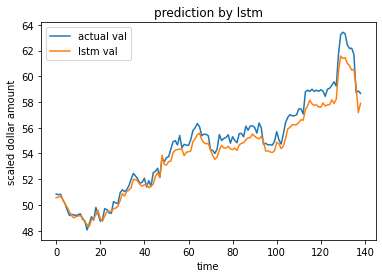

24.356421657662043
4.935222554015375
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375]]
Dataframe Shape:  (1259, 6)
1259
ABBV


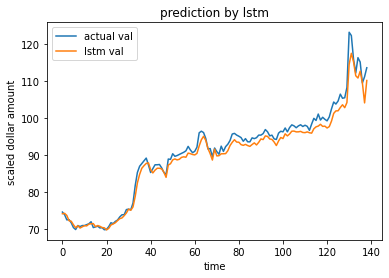

283.9735890286591
16.851515926724787
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787]]
Dataframe Shape:  (1259, 6)
1259
ACN


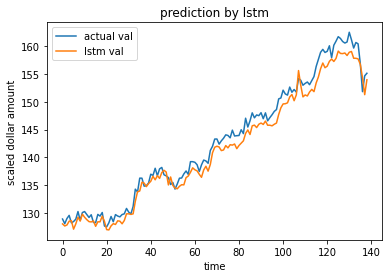

219.9575514881682
14.8309659661186
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186]]
Dataframe Shape:  (1259, 6)
1259
ATVI


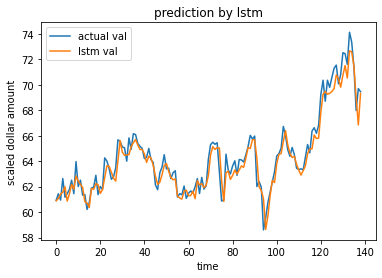

17.56439060732873
4.190989215844957
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957]]
Dataframe Shape:  (1259, 6)
1259
AYI


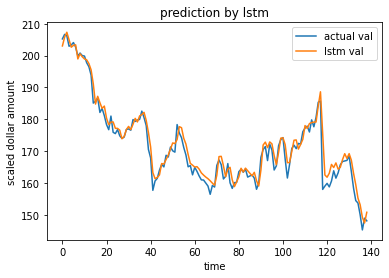

326.0021982318947
18.05553095956734
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734]]
Dataframe Shape:  (1259, 6)
1259
ADBE


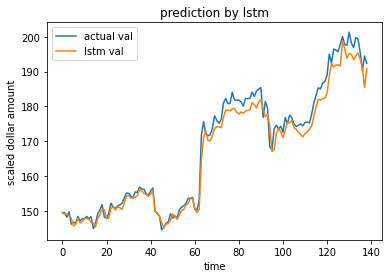

567.644808121066
23.825297650209244
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244]]
Dataframe Shape:  (1259, 6)
1259
AMD


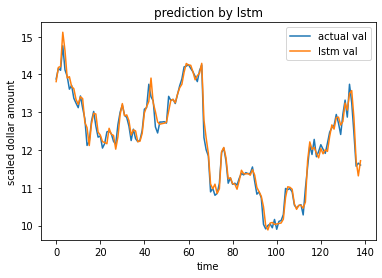

2.8406614277790627
1.6854261857996222
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222]]
Dataframe Shape:  (1259, 6)
1259
AAP


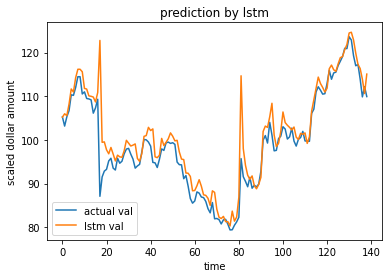

238.38550036923453
15.439737704029643
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643]]
Dataframe Shape:  (1259, 6)
1259
AES


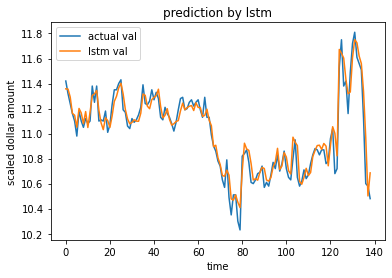

0.18346220506927632
0.42832488261747803
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803]]
Dataframe Shape:  (1259, 6)
1259
AET


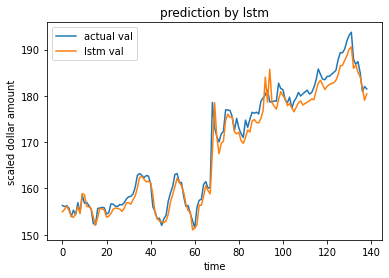

296.9162308016248
17.231257377267184
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184]]
Dataframe Shape:  (1259, 6)
1259
AMG


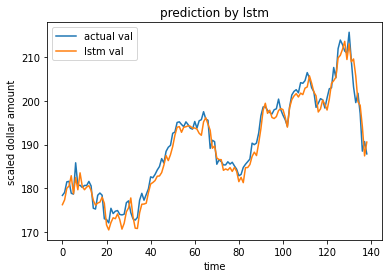

236.63064572619717
15.382803571722457
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457]]
Dataframe Shape:  (1259, 6)
1259
AFL


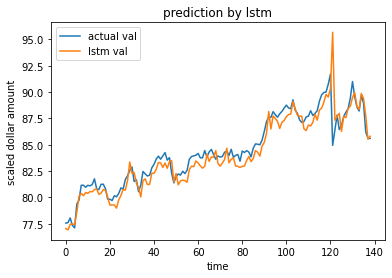

22.274702591423402
4.7196083091103445
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445]]
Dataframe Shape:  (1259, 6)
1259
A


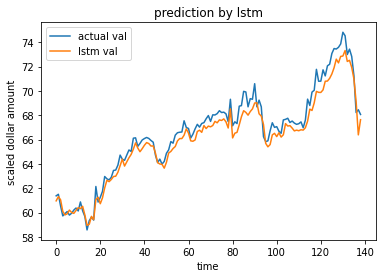

25.15515220315772
5.015491222518261
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261]]
Dataframe Shape:  (1259, 6)
1259
APD


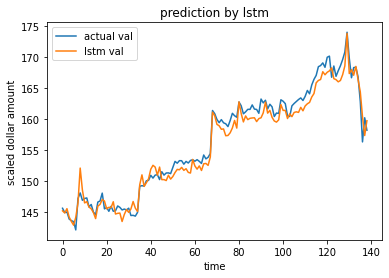

129.41479073475892
11.376062180506878
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878]]
Dataframe Shape:  (1259, 6)
1259
AKAM


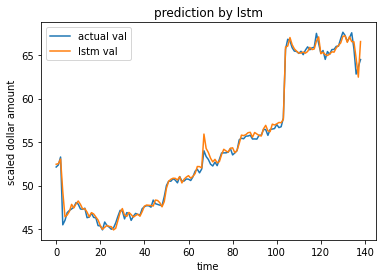

109.97762683585704
10.48702182871081
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081]]
Dataframe Shape:  (1259, 6)
1259
ALK


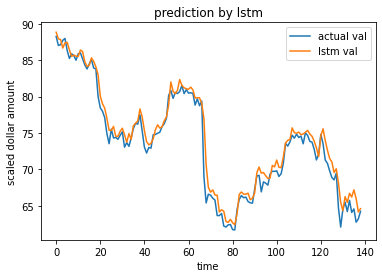

98.42806735729606
9.92109204459348
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348]]
Dataframe Shape:  (1259, 6)
1259
ALB


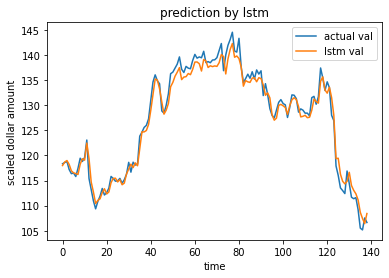

203.85463278637476
14.277767079847422
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422]]
Dataframe Shape:  (1259, 6)
1259
ARE


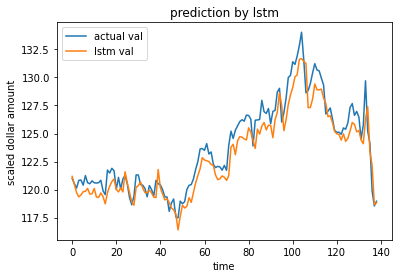

28.86854628939616
5.372945773911752
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752]]
Dataframe Shape:  (1259, 6)
1259
ALXN


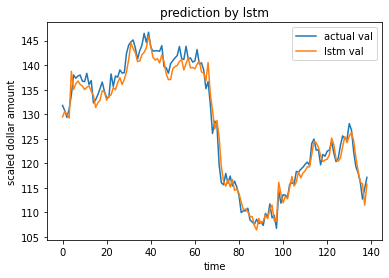

281.03060399636126
16.76396743006742
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742]]
Dataframe Shape:  (1259, 6)
1259
ALGN


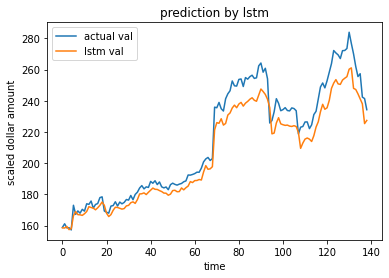

2296.3646591523675
47.92039919650469
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

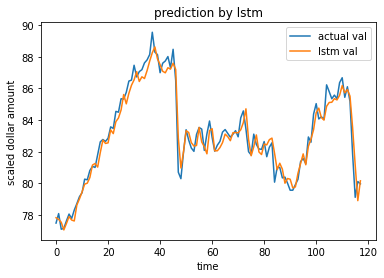

15.592479447505873
3.948731371909955
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

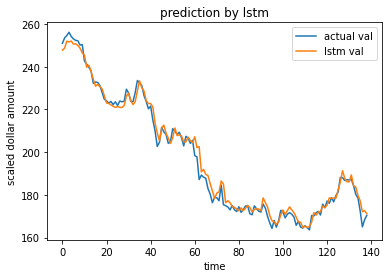

1474.5214325004233
38.39949781573222
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

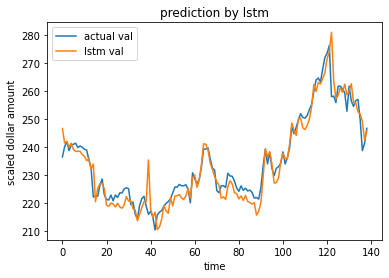

466.99988599561215
21.61018014722719
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

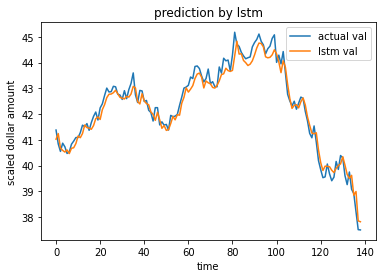

5.0654382877415385
2.250652858115071
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

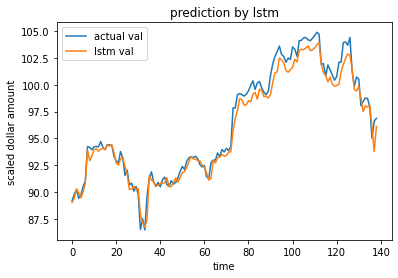

47.81387431549629
6.914757719218822
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

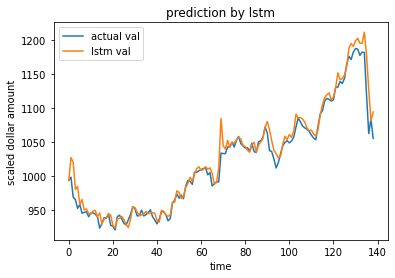

10973.947369011892
104.75661014471541
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

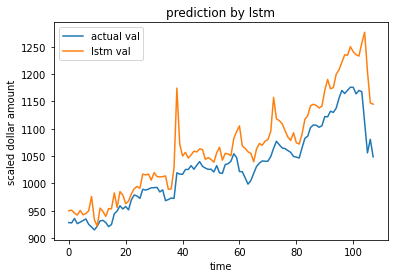

13879.998493572175
117.8134054069068
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

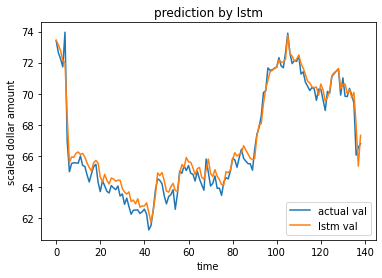

22.32984993340448
4.725447061750293
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

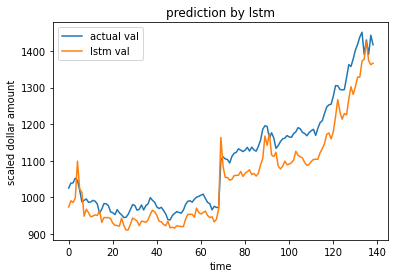

37804.57186079152
194.4339781540035
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

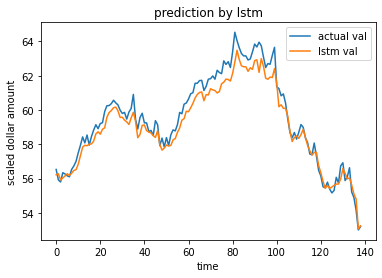

12.177028713887728
3.4895599599215554
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

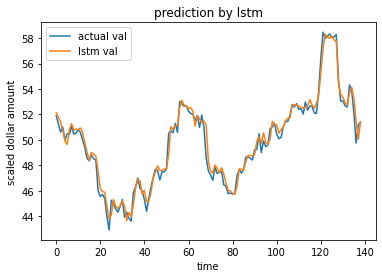

23.032364623852665
4.799204582412868
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

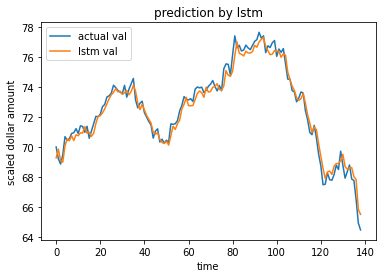

14.977253589544386
3.8700456831340357
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

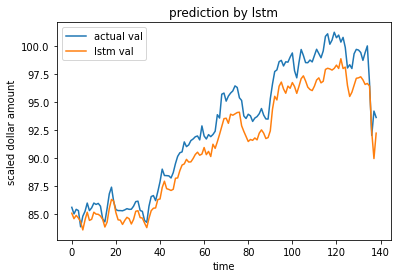

57.248593862350795
7.56628005444887
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

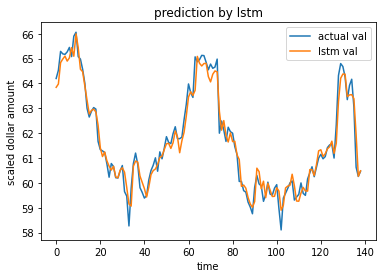

7.621248144266961
2.7606608165921
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919650

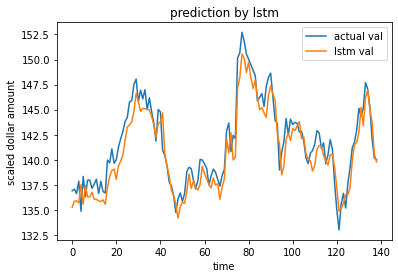

33.47016260361342
5.78534031873782
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991965

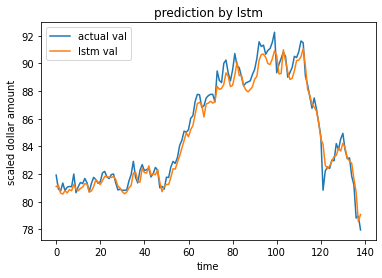

27.60673847623551
5.254211499001112
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

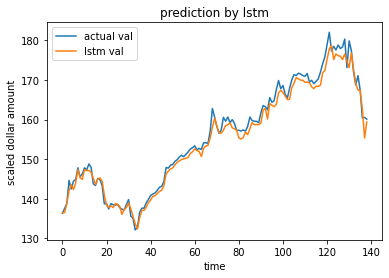

333.9180258795428
18.27342403271874
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

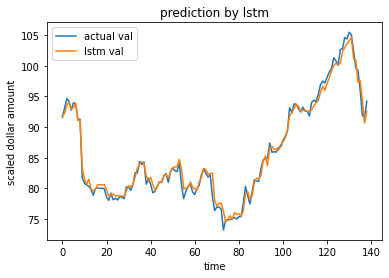

126.55287920214312
11.24957240085787
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

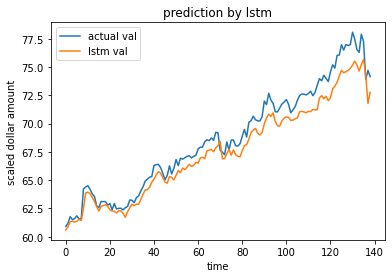

39.31651396439467
6.270288188304798
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

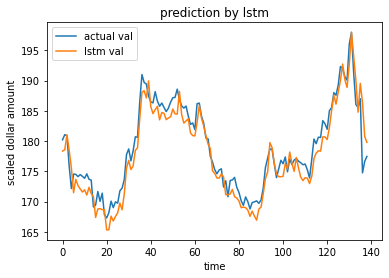

100.33262846981403
10.016617616232239
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

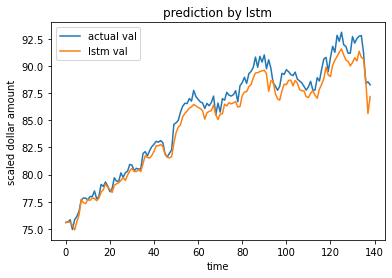

44.9040302057469
6.701046948481028
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991965

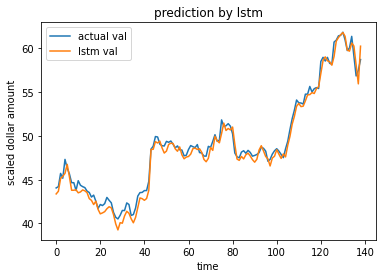

62.52744134671069
7.907429503113556
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

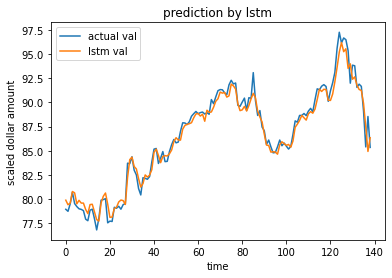

46.00194613490486
6.7824734525764905
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

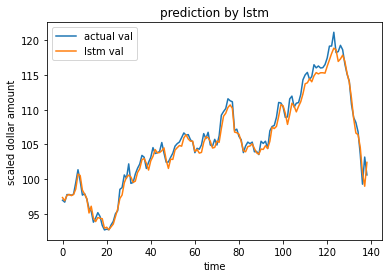

87.16448846104015
9.336192396316614
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

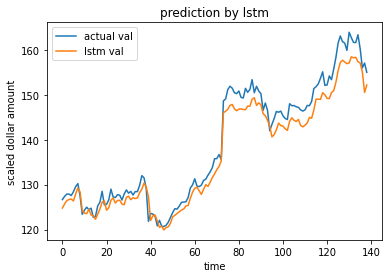

316.7802328880193
17.798321069359865
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

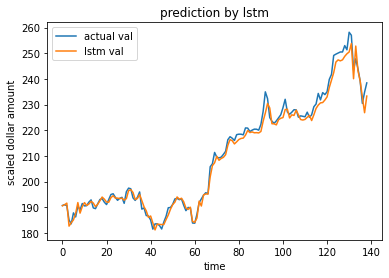

864.3689159429732
29.400151631292196
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

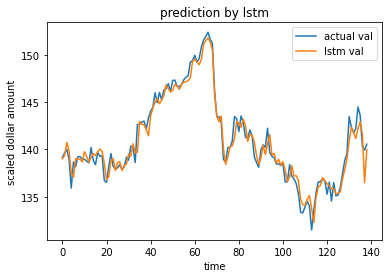

38.198970606649105
6.180531579617493
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

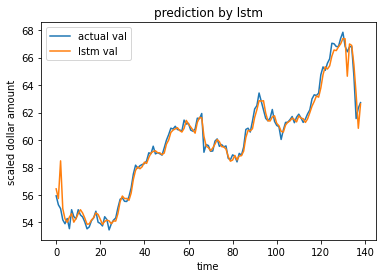

26.34251827540614
5.132496300574034
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

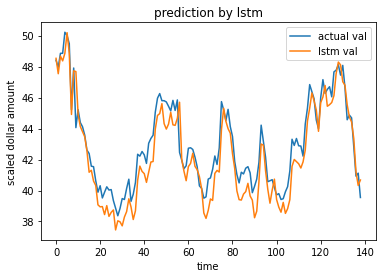

18.04052036339227
4.247413373265224
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

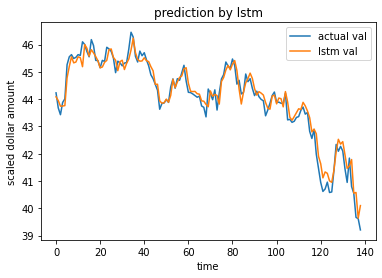

4.249228631386971
2.0613657199504822
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

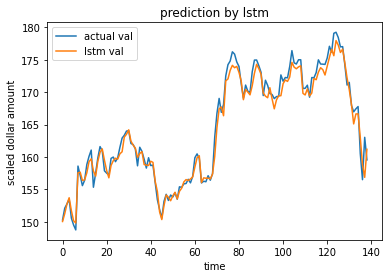

129.22352368116685
11.367652514093086
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

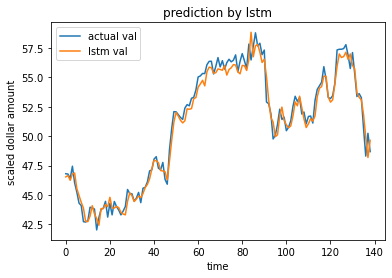

45.516509980966276
6.746592471830967
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

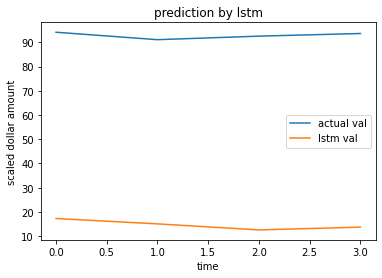

6130.670639807111
78.29859921995482
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

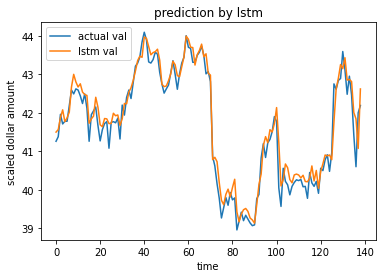

3.8566476118247714
1.9638349247899558
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

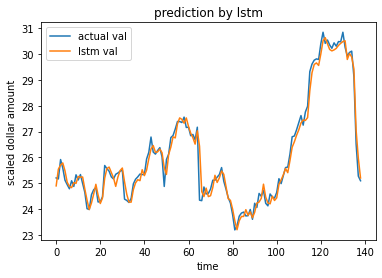

7.779370945078709
2.7891523703589067
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

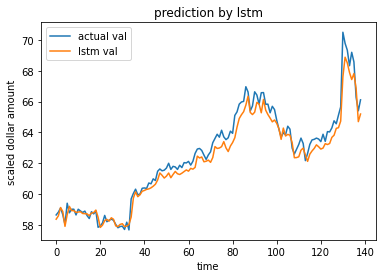

16.567846391531763
4.070361948467453
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

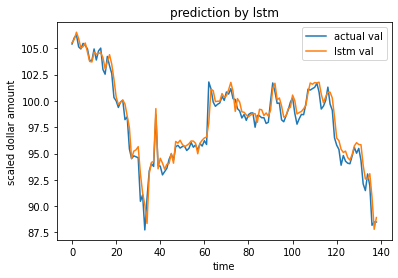

30.725060045206423
5.543019037059716
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

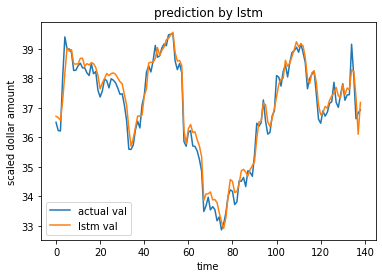

5.651564889952721
2.377302019086494
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

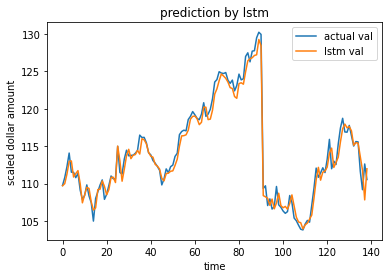

76.26607402469809
8.733044945761936
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

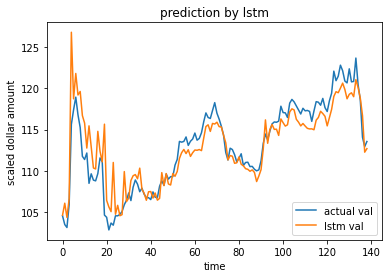

45.00812777622106
6.708809713818172
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

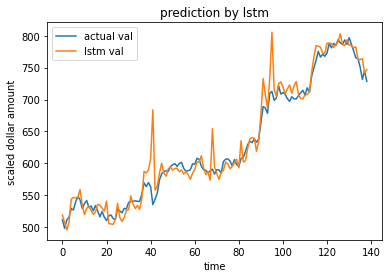

17016.51166465203
130.44735207987944
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

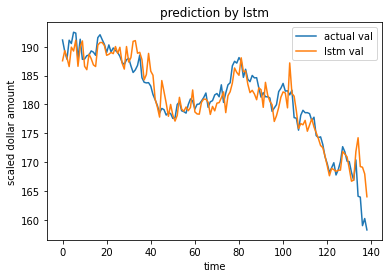

95.76708867239562
9.786066046803262
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

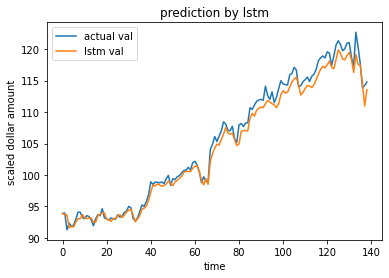

180.0445608493001
13.418068447034399
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

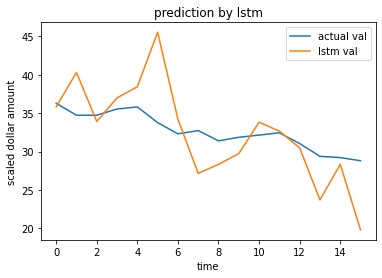

43.93356954219735
6.62824030510341
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991965

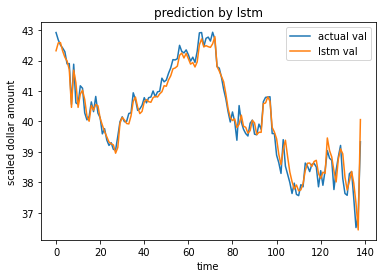

4.443209482759134
2.1078921895483966
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

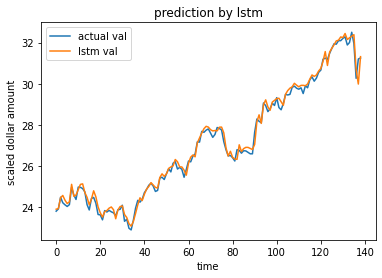

14.60400569996386
3.821518768757241
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

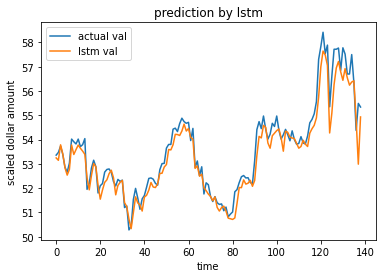

6.144283839368513
2.4787665963879117
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

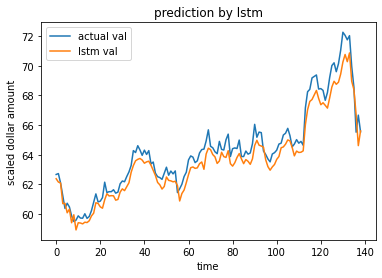

15.767280548221839
3.970803514179698
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

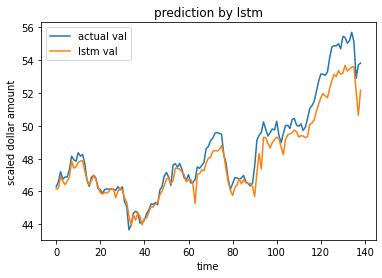

14.985499487313149
3.871110885432391
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

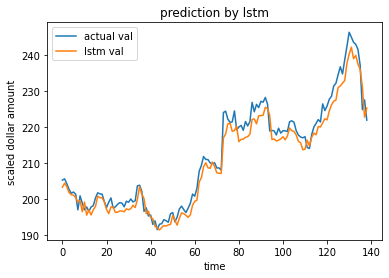

376.8720366715024
19.413192335922044
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

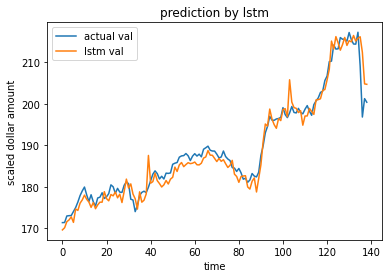

300.1040670176094
17.32351197123751
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

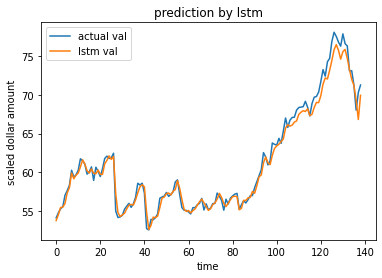

83.55776522360492
9.140993667189848
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

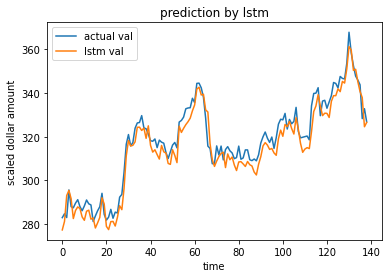

756.1835412596263
27.498791632717722
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

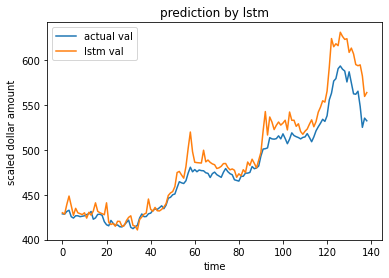

6178.500775546937
78.60343997273235
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

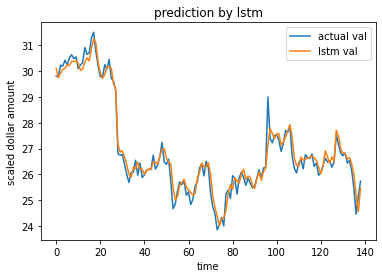

6.4726527979467186
2.54414087619902
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

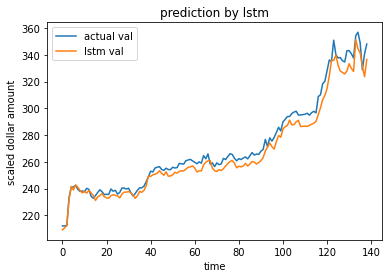

2290.017206632078
47.85412423848208
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

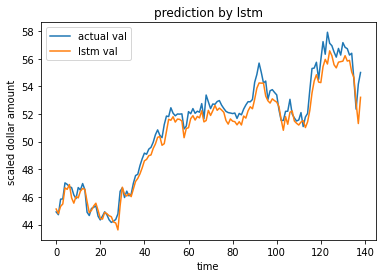

26.071498993220892
5.106025753286101
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

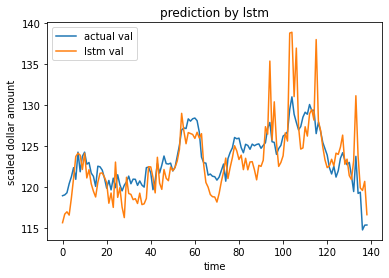

28.051419369064256
5.296359067233287
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

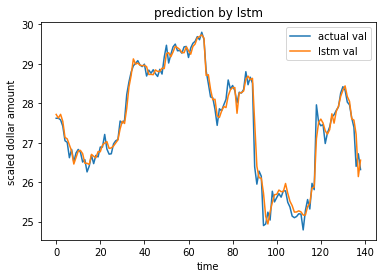

3.5290554378086525
1.8785780361243054
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

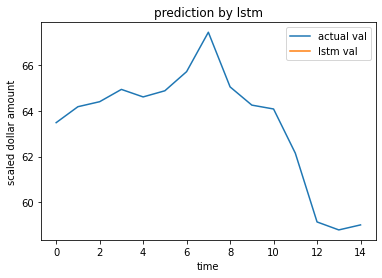

nan
nan
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919650469], ['ALLE', 15.59247944

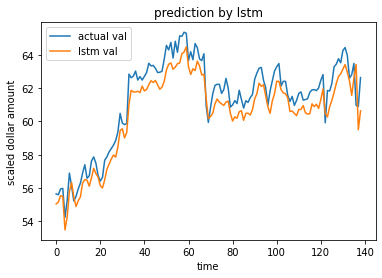

13.758264107990893
3.7092134082566472
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

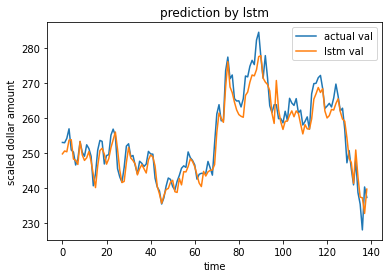

241.52421296361302
15.54104928772871
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

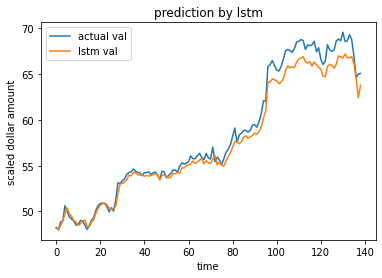

85.49077914597989
9.246122384328464
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

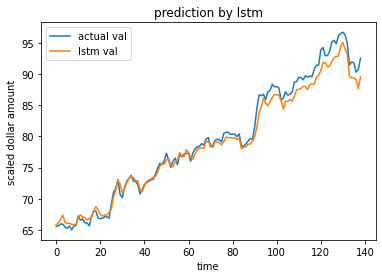

155.19249596673862
12.457628023293143
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

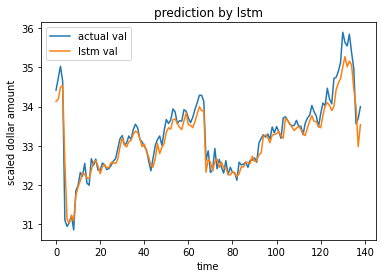

1.553045695402347
1.2462125402203057
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

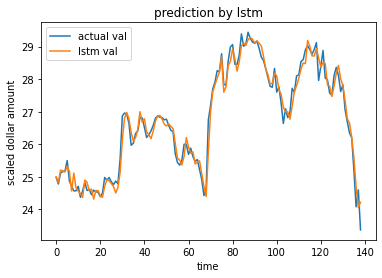

4.882200625884498
2.209570235562676
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

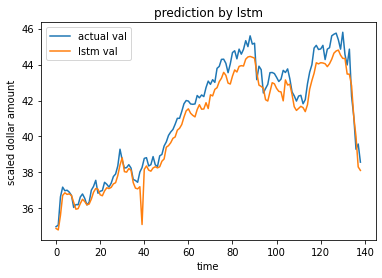

18.321840935729302
4.280401959597872
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

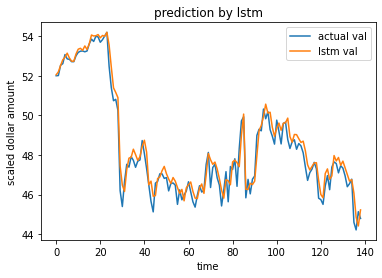

13.598702923157118
3.6876419190530307
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

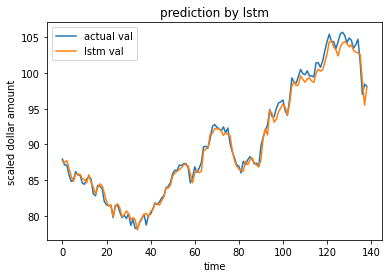

122.67881962215925
11.076047111770484
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

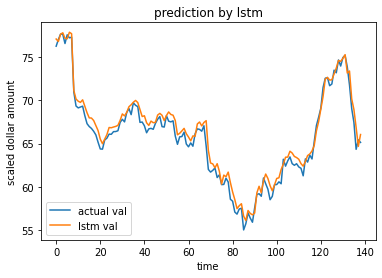

53.189056618753895
7.293082792533888
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

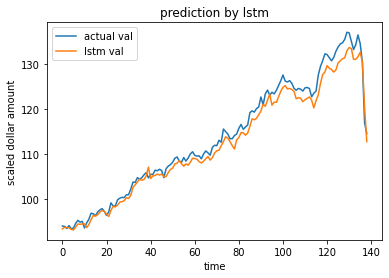

302.79983461325077
17.401144635145435
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

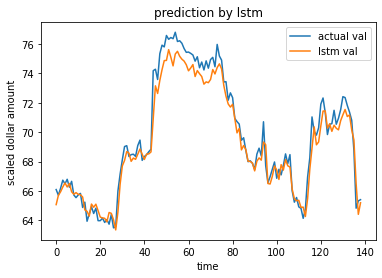

27.504102821167628
5.244435414910515
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

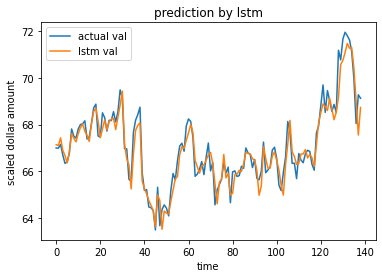

5.200888701026298
2.280545702463842
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

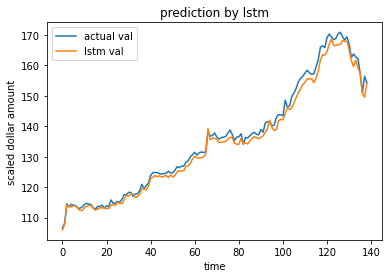

628.4509318152373
25.06892362697763
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

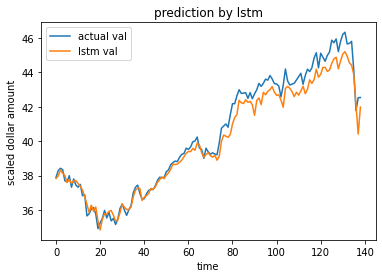

20.132618524911827
4.486938658474375
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

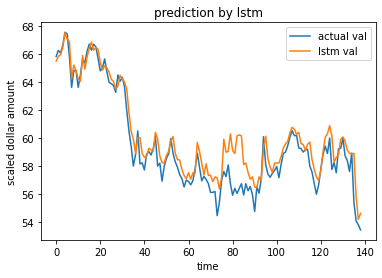

22.040733273481894
4.694755933324106
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

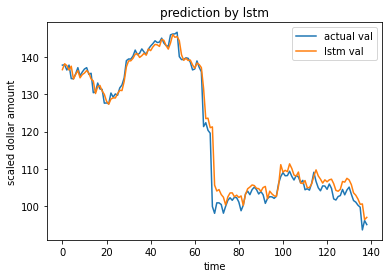

569.8105460494602
23.870704766501138
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

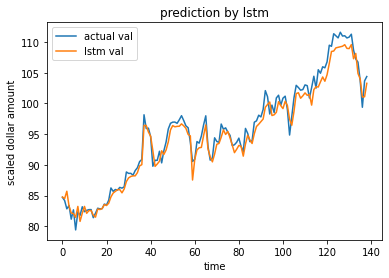

128.58341364462618
11.339462670013345
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

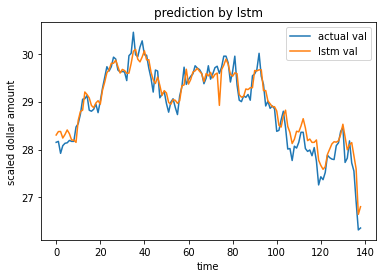

1.1922159191358086
1.0918864039522649
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

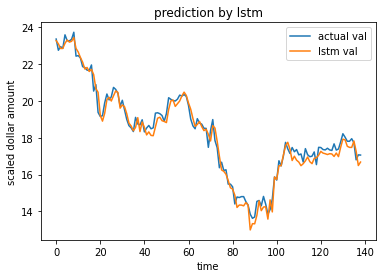

11.985706745989724
3.4620379469309293
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

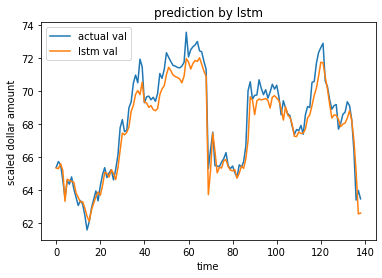

16.108150078721792
4.013495992114828
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

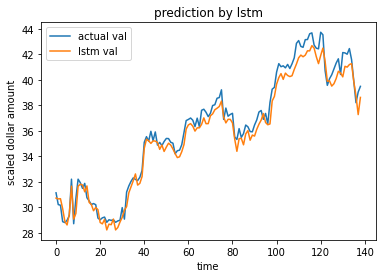

37.37455609737363
6.113473325154337
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

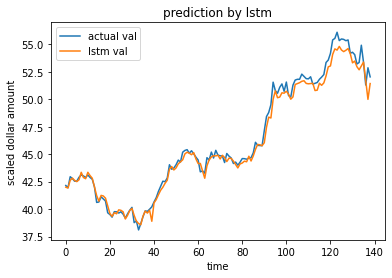

48.877738462409
6.9912615787430665
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991965

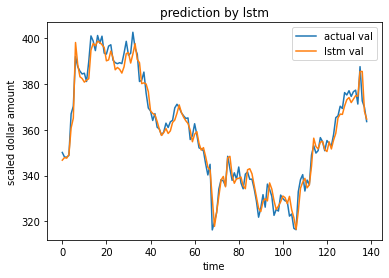

1071.5508533270297
32.73455136895922
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

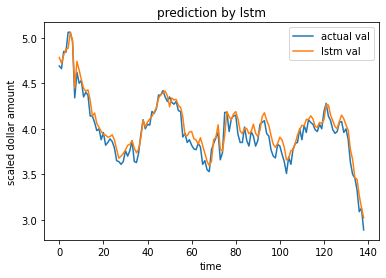

0.22178450448942588
0.4709400221784361
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399

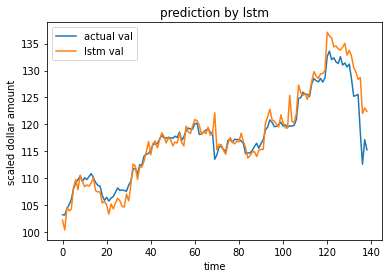

126.11993695103983
11.230313306005307
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

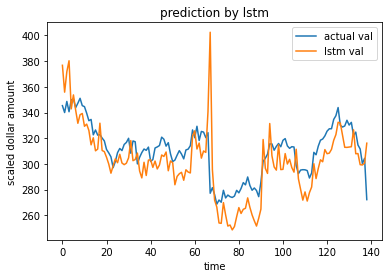

1183.8212499611586
34.40670356138697
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

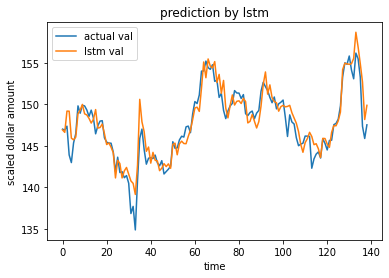

31.901965290417863
5.648182476728055
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

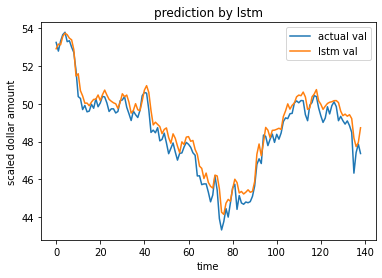

9.656876686154465
3.107551558084671
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

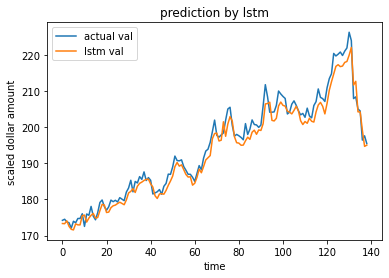

353.53944003384504
18.80264449575764
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

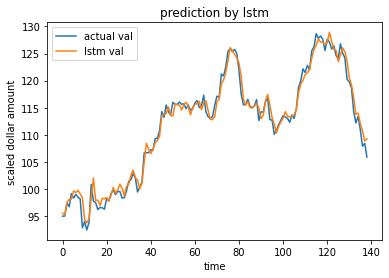

184.9769160573215
13.600621899653026
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

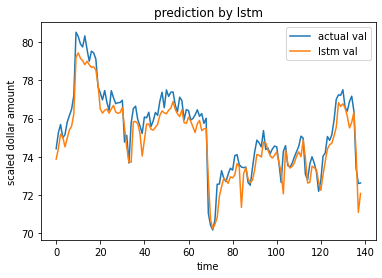

8.078647503075313
2.842296167375123
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

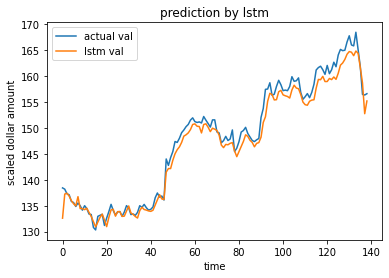

226.39829743020834
15.04653772235355
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

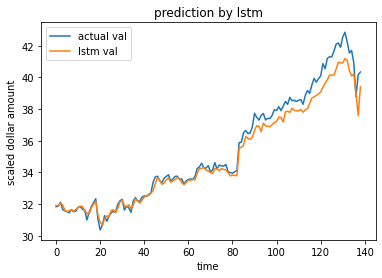

20.977562568181167
4.5801269161652245
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

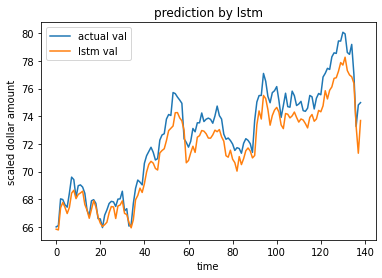

24.46408088862743
4.946117759276201
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

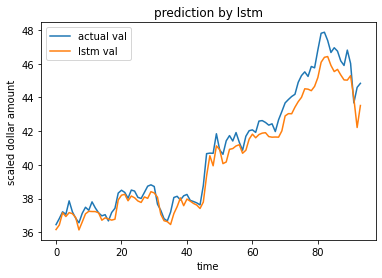

21.914734107682737
4.68131756108072
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

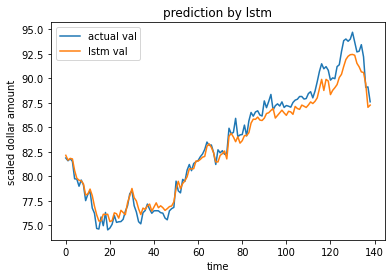

58.89328133495987
7.674195810308717
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

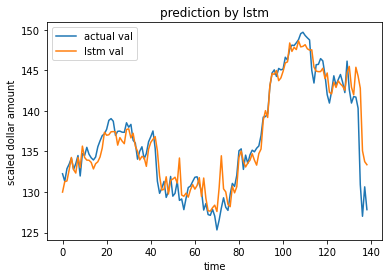

77.96972720630544
8.83004684054991
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991965

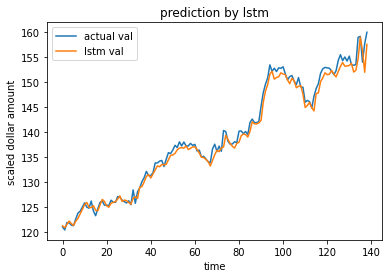

230.5206415957333
15.182906230222635
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

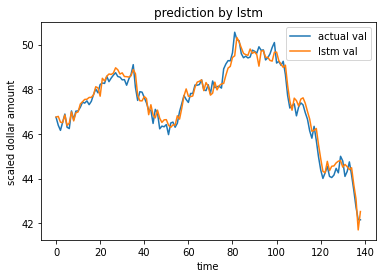

5.933210101958814
2.4358181586396825
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

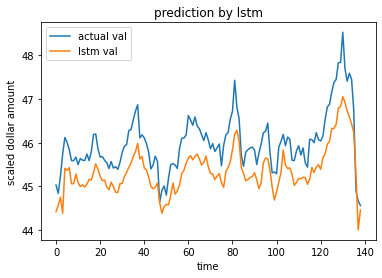

1.1237429800649064
1.0600674412814057
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

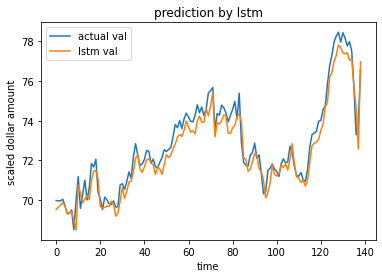

9.9071340942695
3.147560022345801
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919650

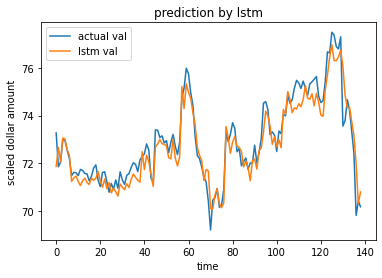

5.776655081188664
2.403467303956653
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

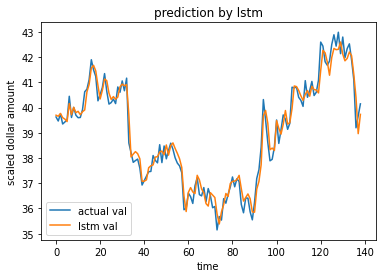

7.816643805285951
2.7958261400319495
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

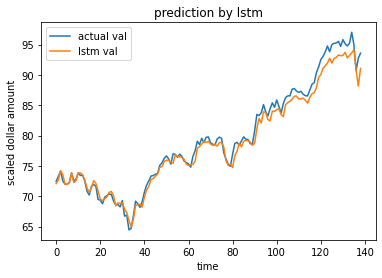

130.06862570256732
11.404763290071712
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

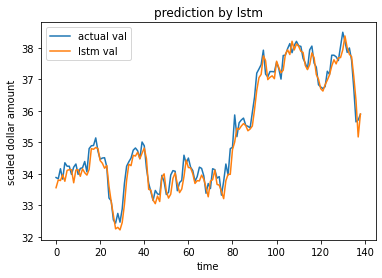

6.0014255683303155
2.4497807184175313
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

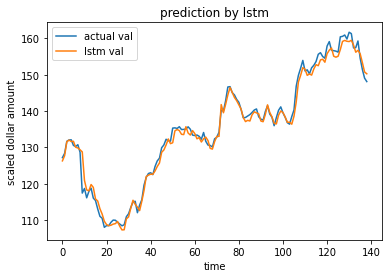

430.0719198963511
20.738175423511855
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

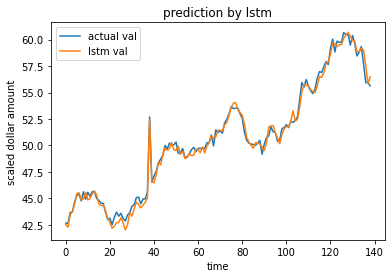

52.364413963033506
7.236325998946807
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

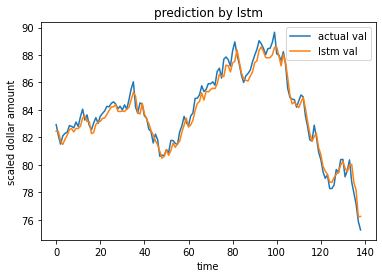

16.352802137399614
4.043859806842915
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

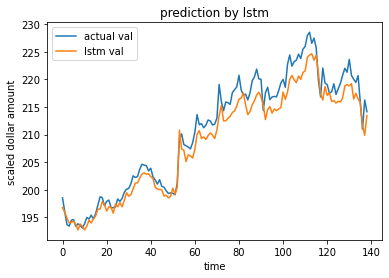

197.5129605070803
14.053930429139042
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

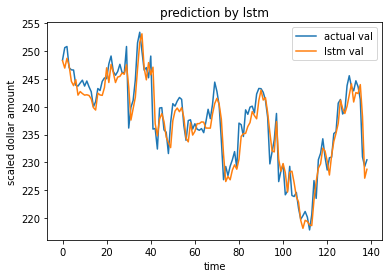

118.47115470328517
10.884445539543352
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

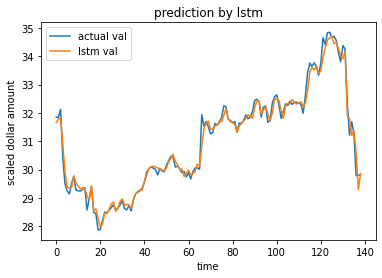

6.066461182722621
2.4630187134332986
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

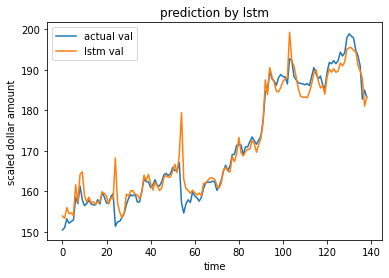

386.75927063510204
19.66619614046148
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

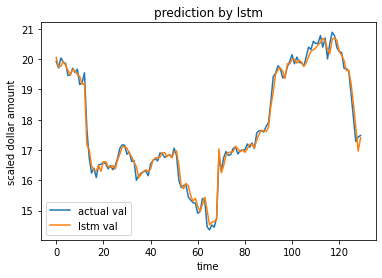

6.272153772113951
2.5044268350490797
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

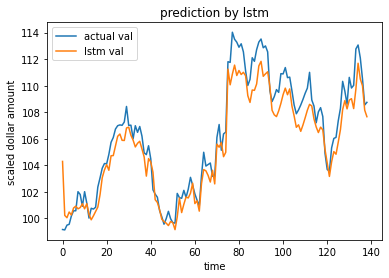

32.055394373339254
5.661748349524134
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

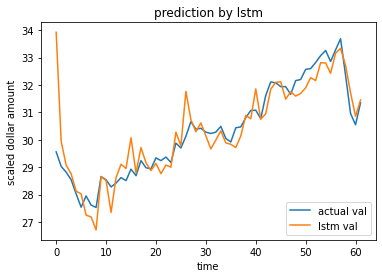

5.394666969330596
2.3226422387726
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919650

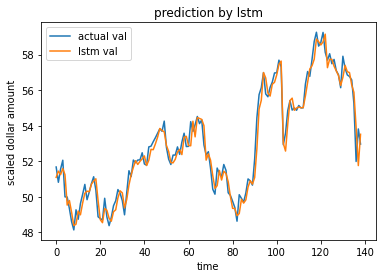

17.002824180367583
4.123448093570183
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

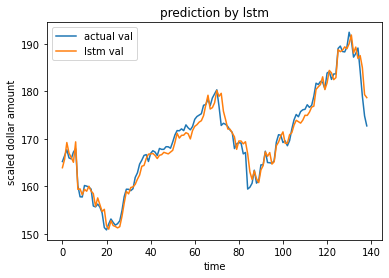

188.32139249051306
13.723024174376182
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

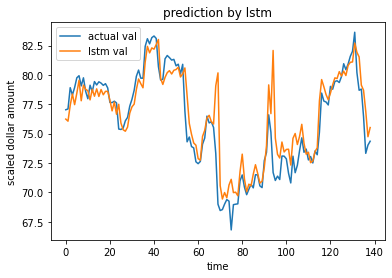

29.71657327326553
5.4512909730875245
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

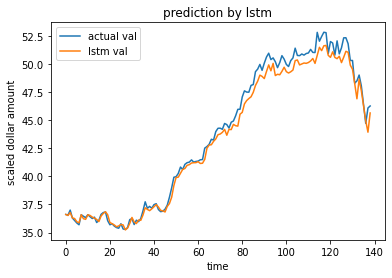

72.56422910845185
8.518464011102697
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

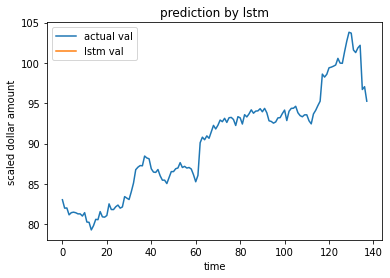

nan
nan
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919650469], ['ALLE', 15.59247944

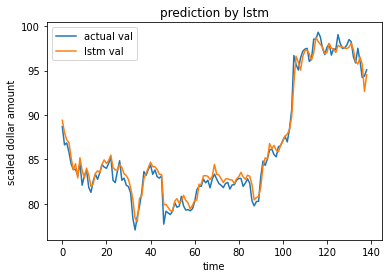

81.77523147465944
9.042965856103816
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

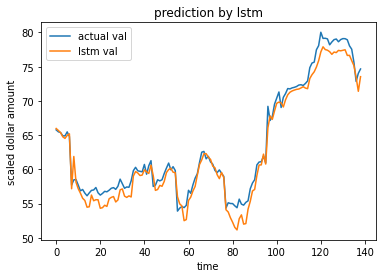

130.05125429856676
11.404001679172394
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

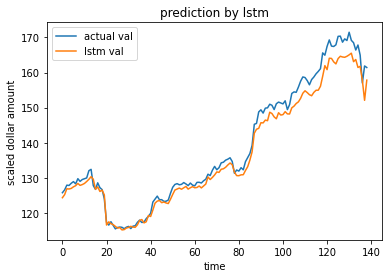

538.7144865617831
23.21022375079101
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

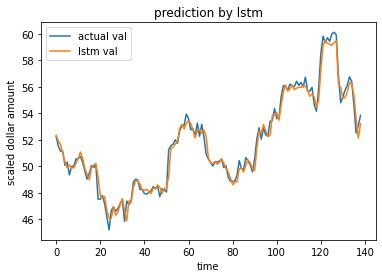

23.40230844363002
4.83759324908885
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991965

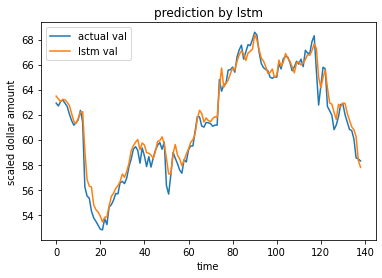

31.95646051584277
5.653004556502919
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

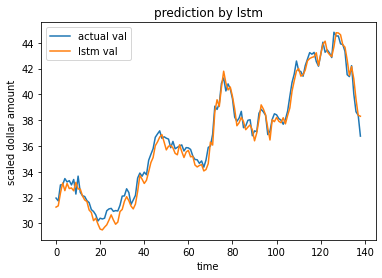

34.33045978435806
5.85922006621684
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991965

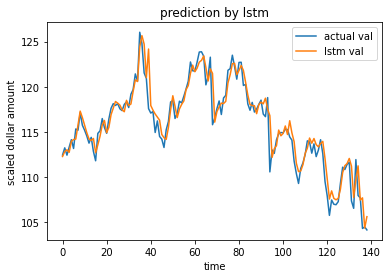

40.36747411299236
6.353540281842271
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

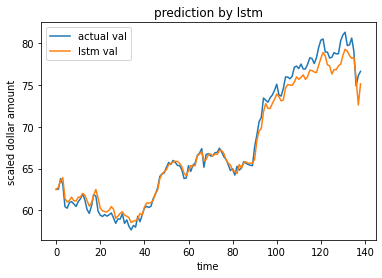

93.85675632373405
9.687969669839704
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

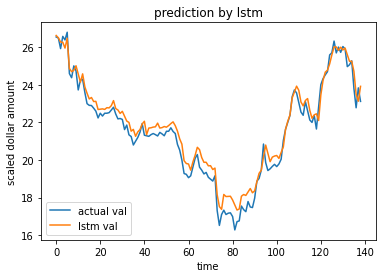

12.804654068254711
3.578359130698694
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

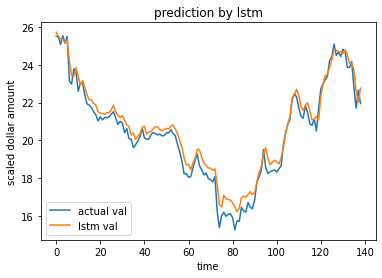

12.464499457306168
3.5305098013326868
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

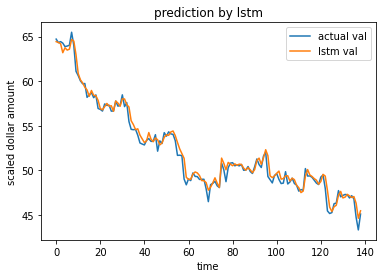

48.97680878298553
6.998343288449455
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

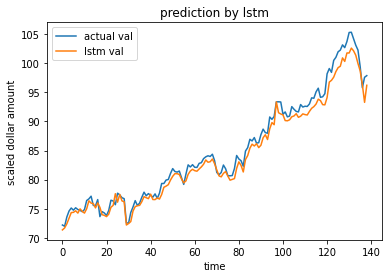

153.82736452729822
12.402716014135702
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

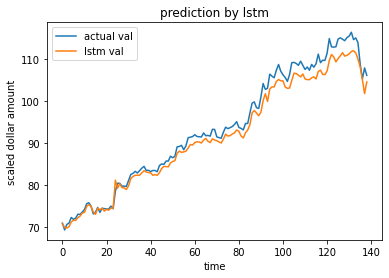

352.6395738177688
18.778700003401962
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

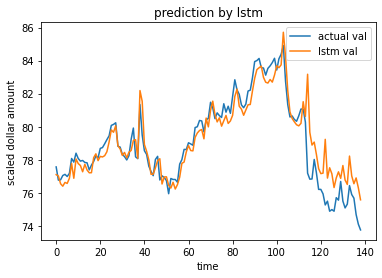

11.528549149435767
3.3953717247800377
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

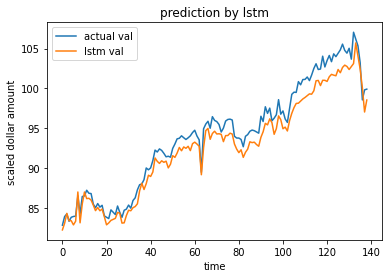

82.82157708368709
9.100636081268556
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

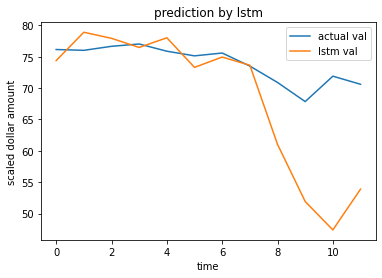

159.85150019228914
12.643239307720515
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

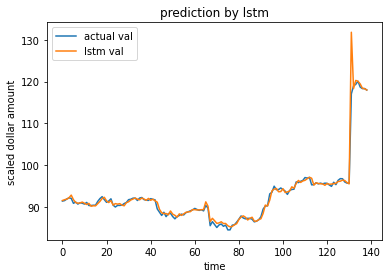

109.98668117563761
10.487453512442265
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

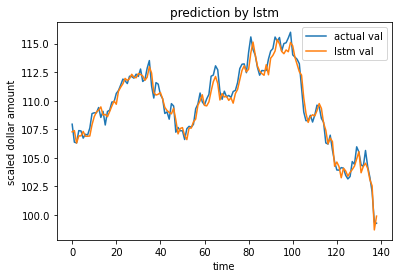

23.102535832921333
4.806509735028249
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

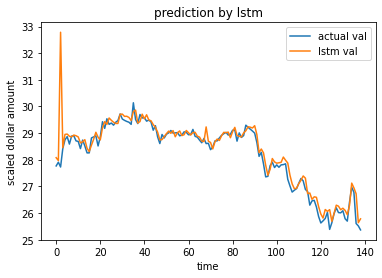

2.970951011315995
1.7236446882452297
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

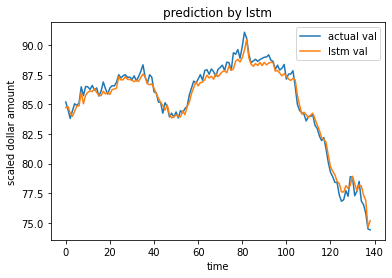

24.963435261181154
4.996342188159369
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

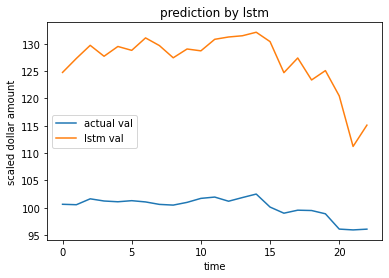

740.1323609405481
27.20537375116446
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

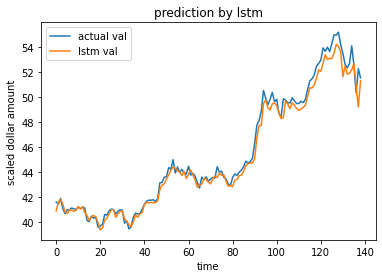

40.36681837781663
6.3534886777121615
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

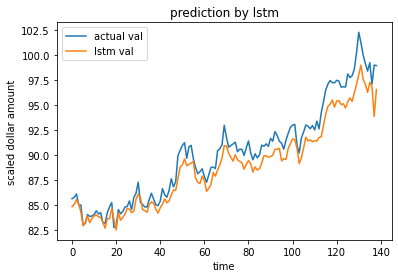

41.52087228483966
6.443669163205049
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

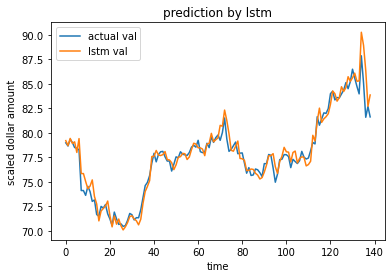

31.616016908807175
5.622812188647881
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

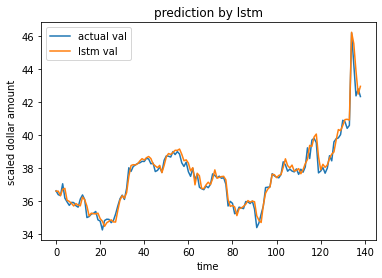

7.709086756698529
2.7765242222423576
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

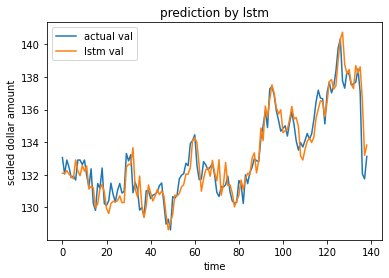

13.765285550319367
3.710159774230669
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

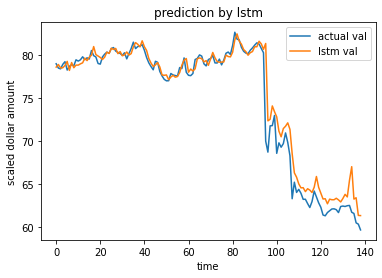

98.2478439355705
9.91200504113928
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919650

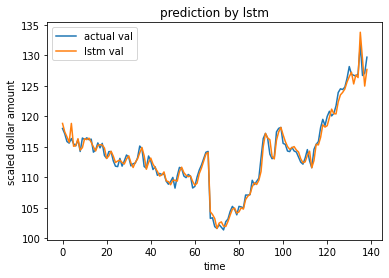

73.89306655313383
8.596107639689828
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

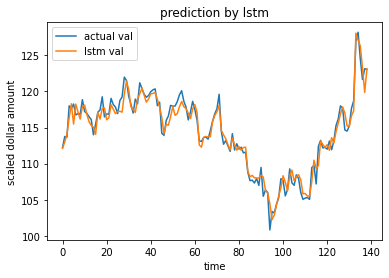

51.921968099274075
7.205689980791158
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

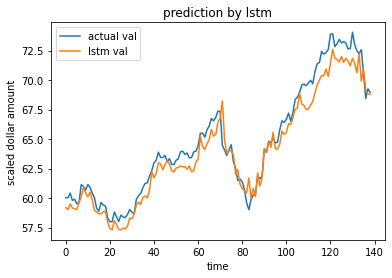

41.377533126470496
6.43253706763284
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

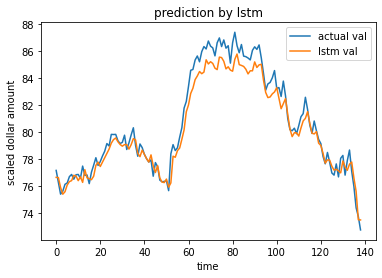

24.704864852294573
4.9703988624953
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991965

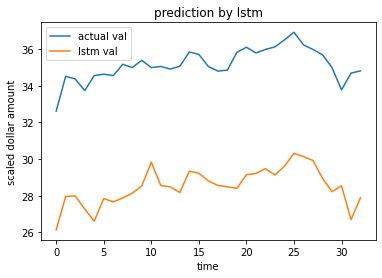

45.871275721691326
6.772833655250314
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

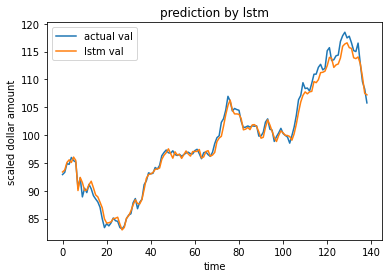

160.46798789145032
12.667595979168672
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

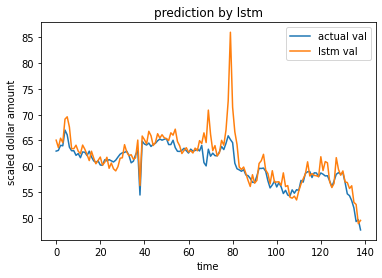

36.81917459829785
6.067880568888765
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

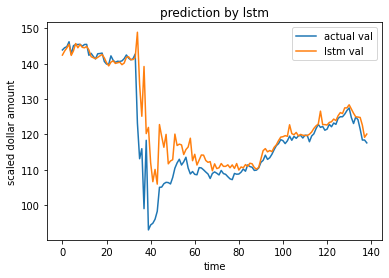

351.760754370693
18.755286038093182
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

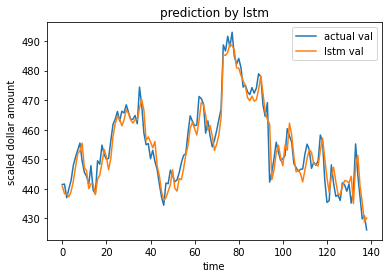

373.1197019398693
19.31630663299455
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

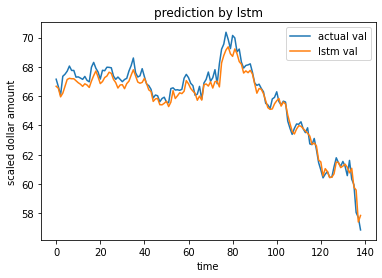

13.389334695531797
3.6591439839847513
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

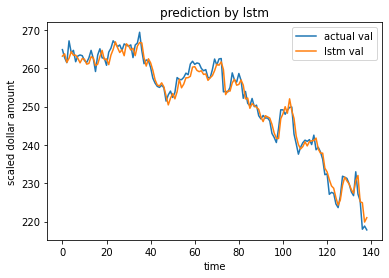

316.28850477982616
17.784501814215268
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

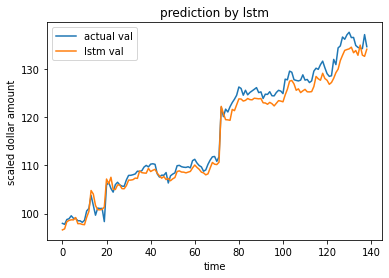

269.76973525542616
16.424668497580893
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

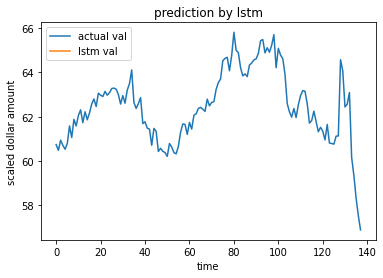

nan
nan
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919650469], ['ALLE', 15.59247944

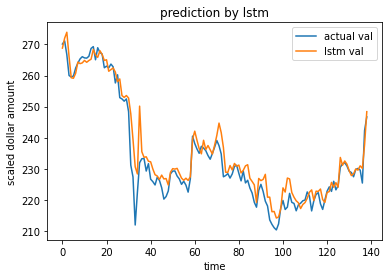

534.6601564400465
23.122719486255214
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

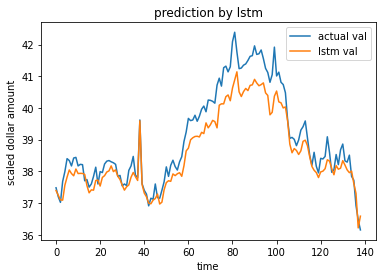

3.815559328976637
1.9533456757513856
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

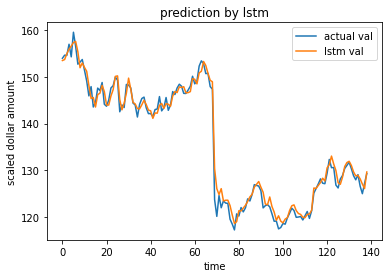

303.02733028921665
17.407680209873362
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

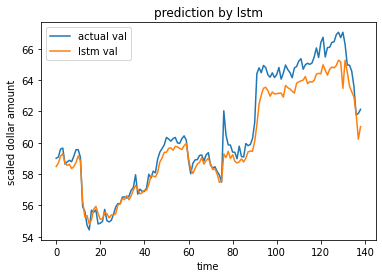

22.59787987916729
4.75372273898755
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991965

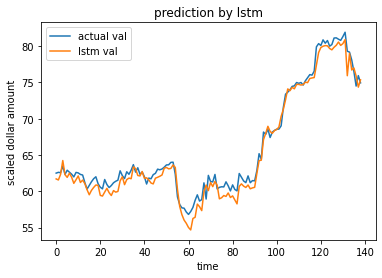

107.65713520750083
10.375795642142382
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

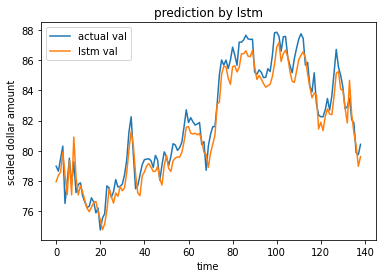

25.410057859624747
5.040839003541449
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

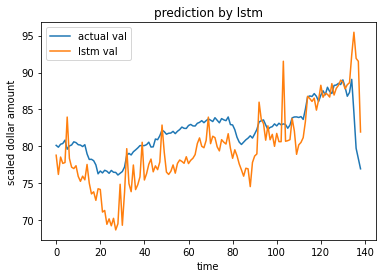

42.756810251811594
6.538869187543944
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

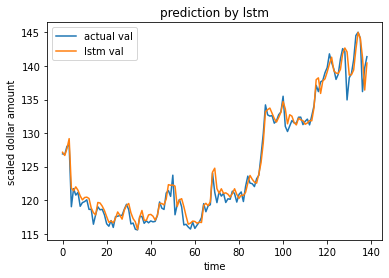

143.9862478730743
11.999426981030147
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

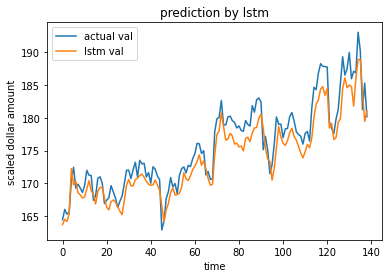

79.4918292133192
8.91581904332514
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919650

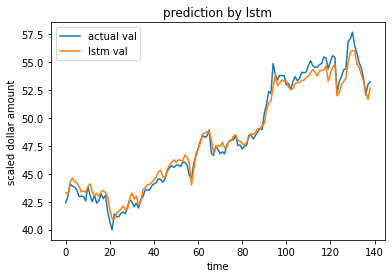

43.12252681045023
6.566774460147861
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

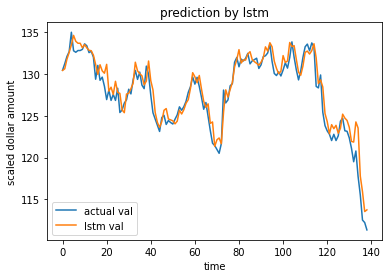

38.66667916967321
6.218253707406381
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

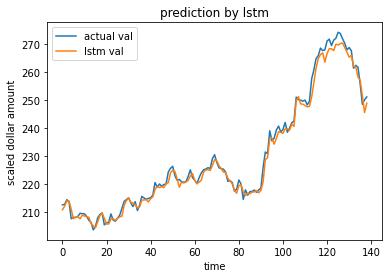

809.6644228924087
28.454602841937692
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

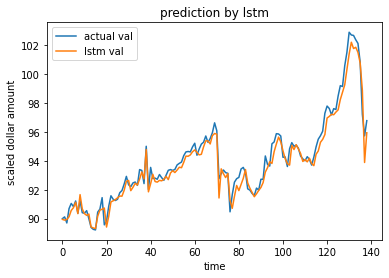

16.053704204837004
4.0067074019495115
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

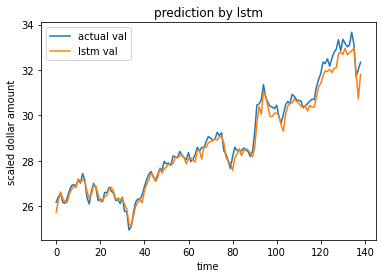

8.867323599771321
2.9778051648439527
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

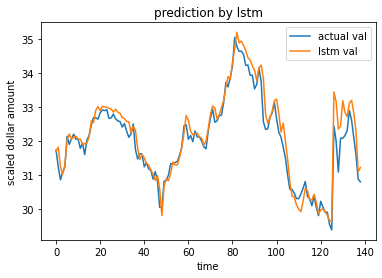

3.0566660663386487
1.7483323672398932
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

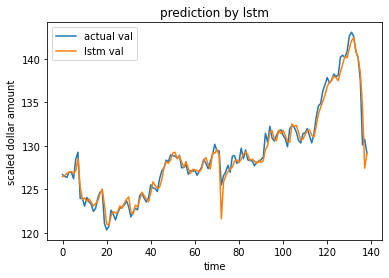

49.638939145327676
7.045490695851331
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

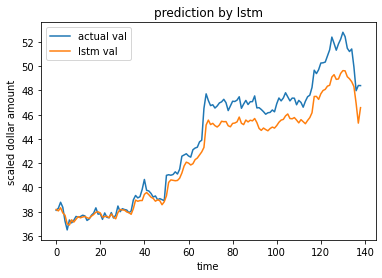

40.33801766876896
6.351221746150024
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

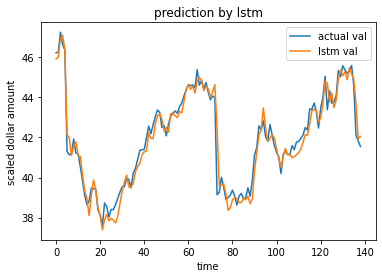

10.648417584241619
3.263191318976198
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

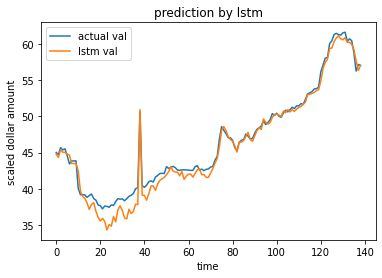

97.61379053048663
9.879969156353
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196504

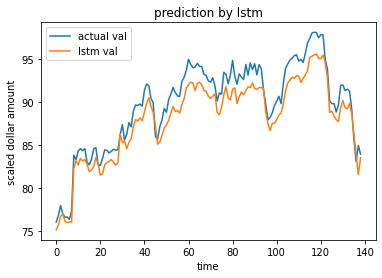

50.75684566300943
7.124383879537193
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

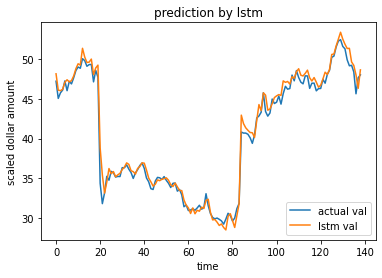

107.9050306506056
10.387734625538217
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

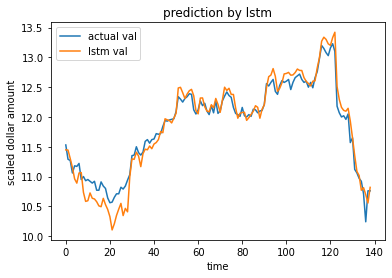

1.1800677641862467
1.0863092396671616
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

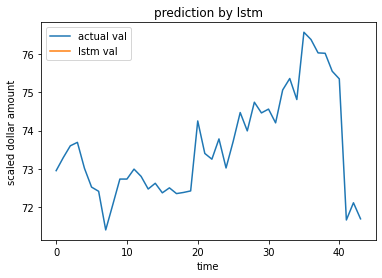

nan
nan
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919650469], ['ALLE', 15.59247944

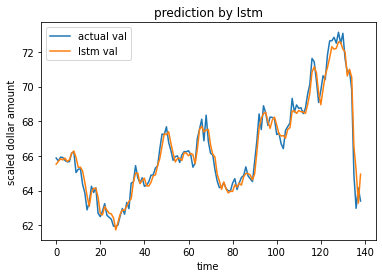

14.055159444868425
3.7490211315579995
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

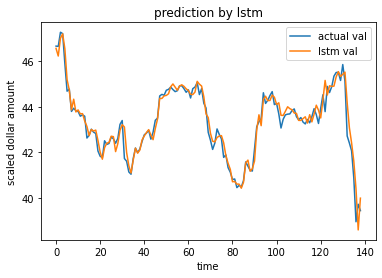

4.53905795763832
2.130506502604092
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991965

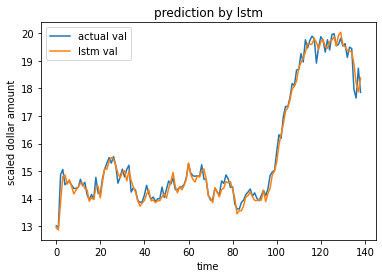

8.88357490372734
2.980532654363535
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991965

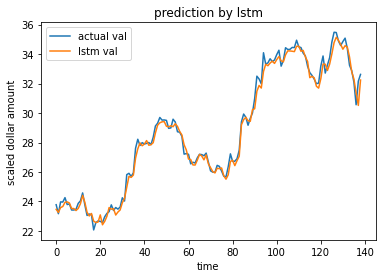

31.877719940113693
5.646035772124871
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

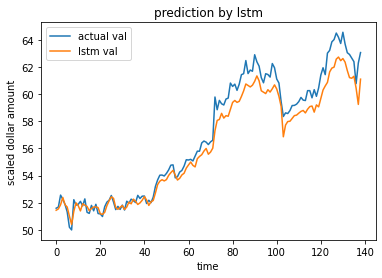

34.513352277609386
5.874806573633671
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

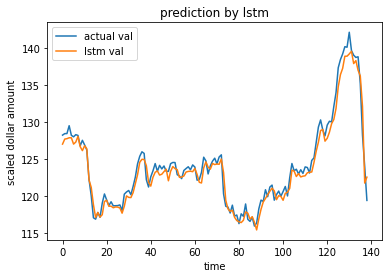

62.57535230767093
7.910458413244515
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

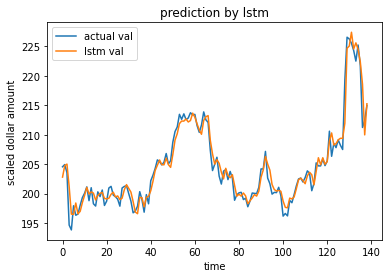

91.6071714526782
9.571163537035515
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991965

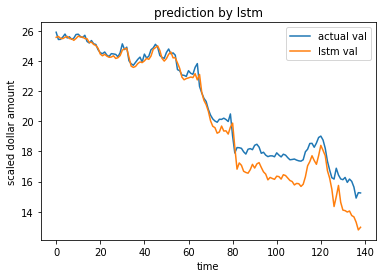

28.948393294659503
5.380371111239401
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

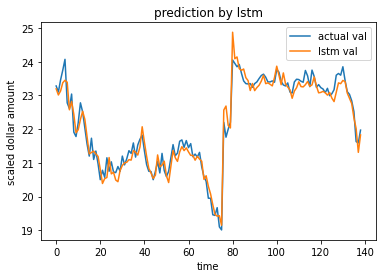

3.154867950773498
1.7761947952782369
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

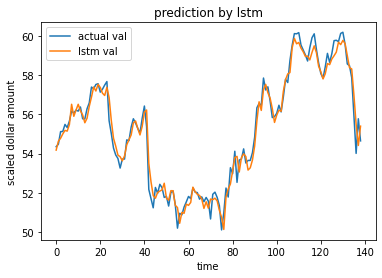

15.549180118363385
3.9432448717221944
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

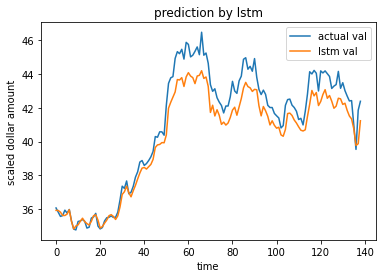

21.65195487627856
4.653166113118955
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

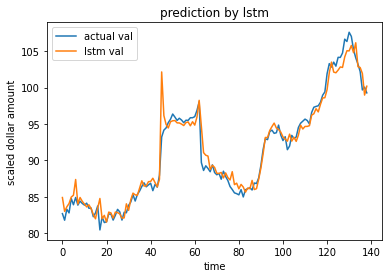

93.3207698698901
9.660267587903045
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991965

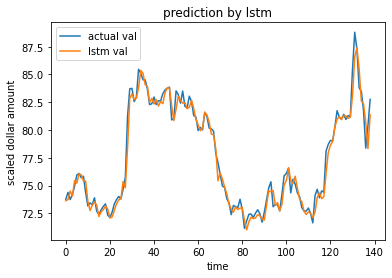

39.60528981317679
6.293273378233047
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

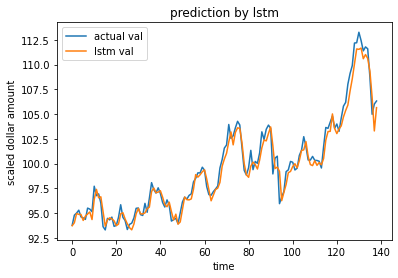

43.06579955898782
6.562453775760087
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

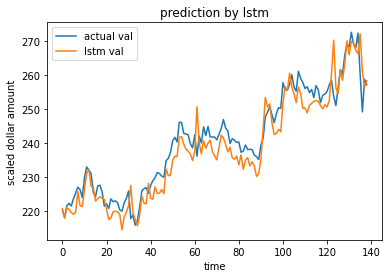

422.6513996298787
20.558487289435444
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

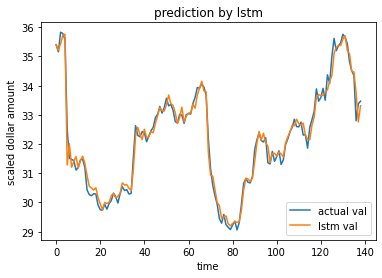

5.9423989912631
2.4377036307277185
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991965

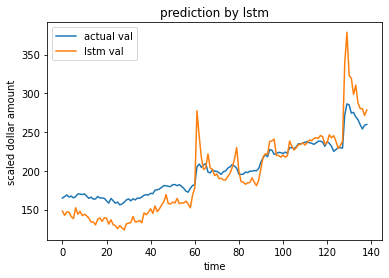

3857.032089477973
62.10500856998551
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

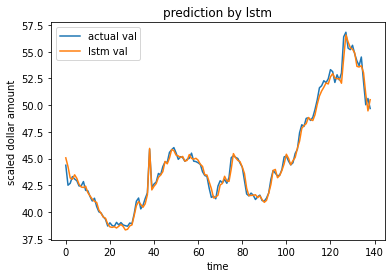

40.99319221719785
6.402592616838732
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

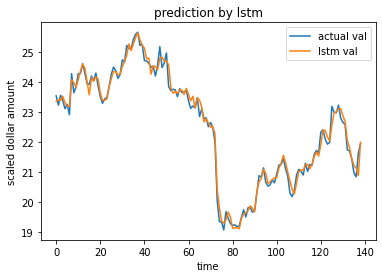

6.463695990413944
2.5423799854494495
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

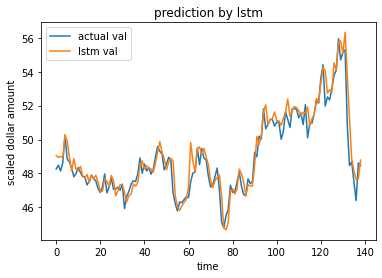

10.943074948088402
3.3080318843820717
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

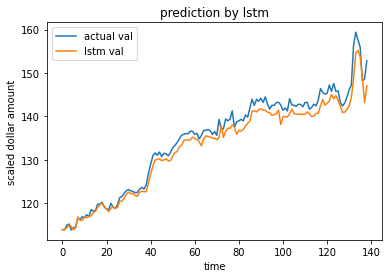

228.3925287664433
15.112661207293813
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

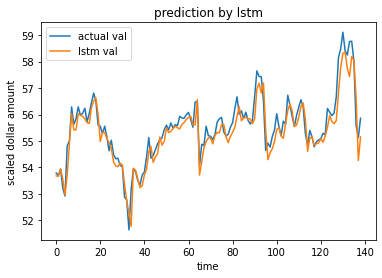

2.80611711476147
1.6751468934876936
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

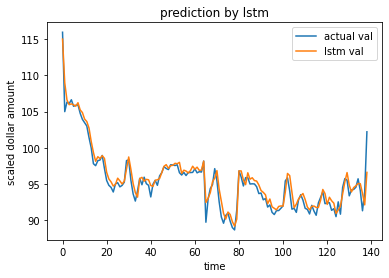

34.99469007902208
5.915630995846688
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

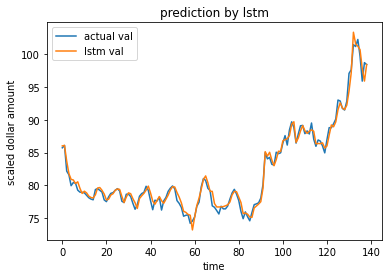

82.87062265043707
9.103330305467175
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

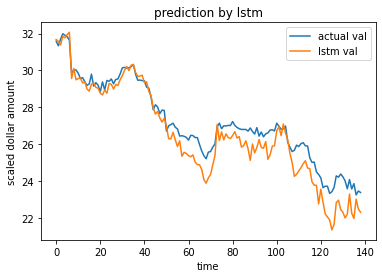

12.123948207115893
3.481946037364148
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

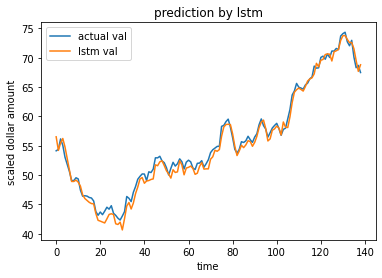

150.74902208010096
12.277989333767193
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

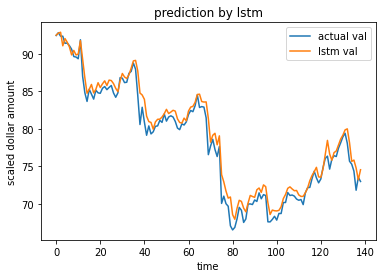

102.26850504960704
10.112789182495947
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

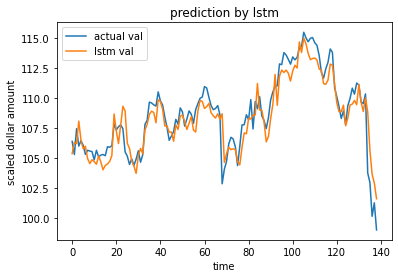

18.152116245043903
4.260530042734578
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

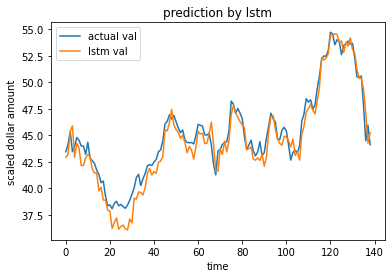

36.037301192565394
6.003107627934501
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

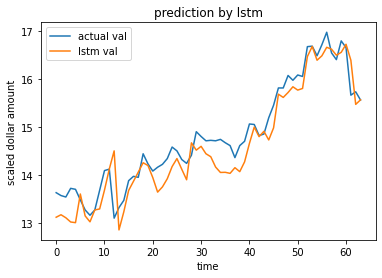

2.4563036065711827
1.5672599039633417
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

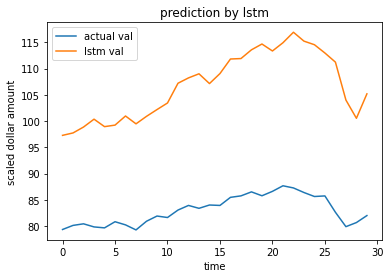

605.9247643740464
24.61553908355546
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

HOLX


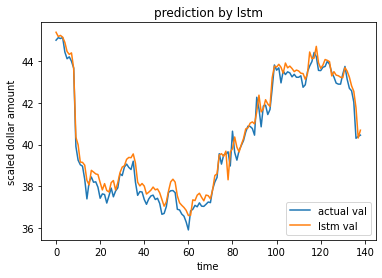

14.617767255182276
3.8233188796100013
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

HD


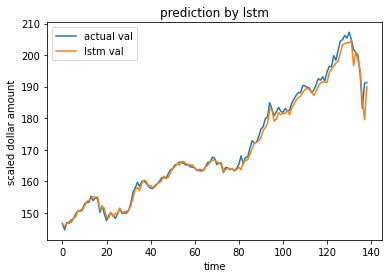

554.9233065561167
23.556810194848467
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

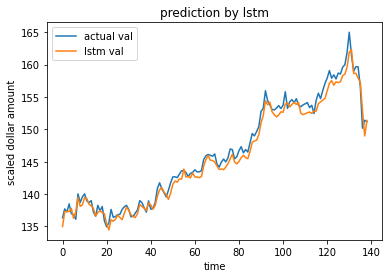

118.05549116838021
10.865334379041457
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

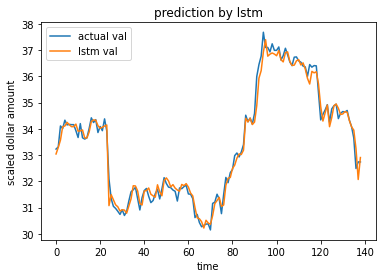

8.464851521376339
2.9094417886213737
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

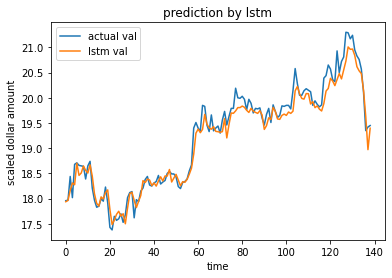

1.8154975580381612
1.3474040069846018
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

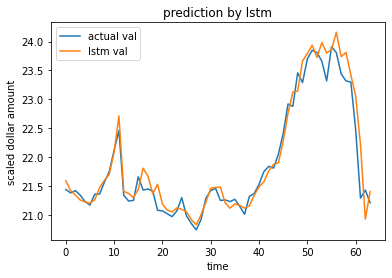

1.8702308194299457
1.3675638264556231
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

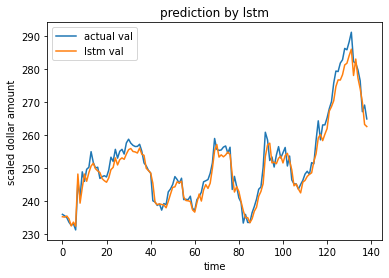

309.3565829687274
17.588535554978062
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

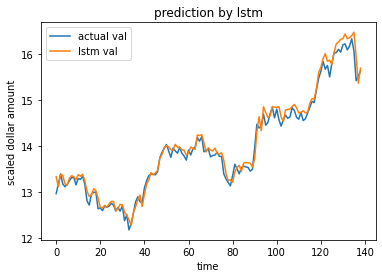

2.245373379882699
1.498456999677568
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

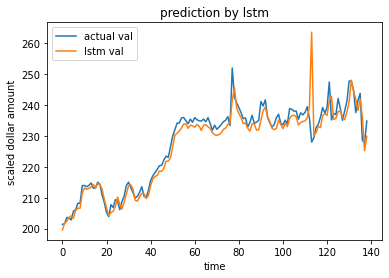

323.7400770456026
17.992778469308252
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

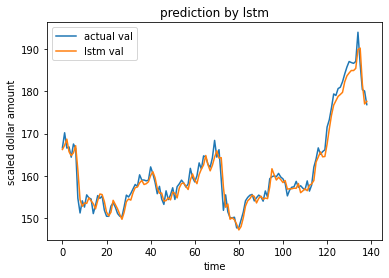

181.24208972301585
13.462618234318905
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

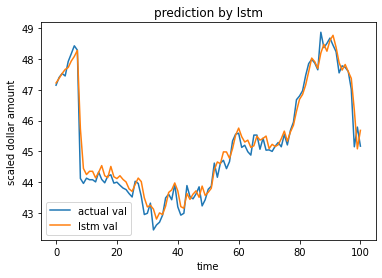

5.914235988256899
2.431920226540521
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

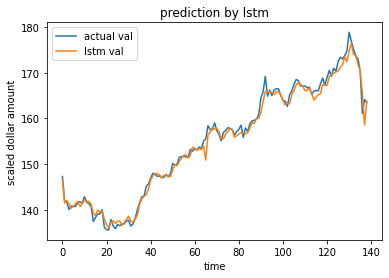

275.3361046419331
16.59325479349766
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

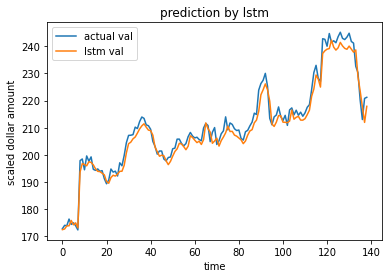

523.4732380986082
22.879537541187503
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

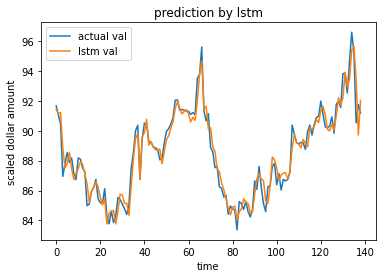

15.67904724560761
3.959677669407904
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

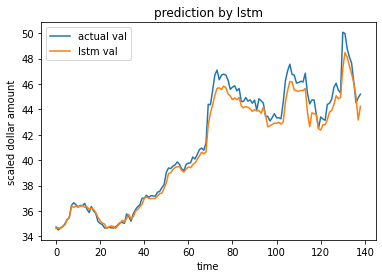

37.9960924751
6.164097052699608
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991965046

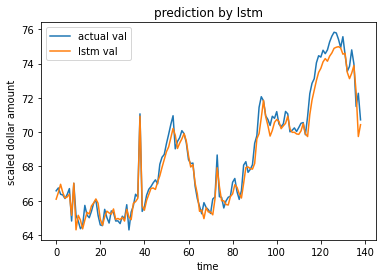

19.943460745243538
4.465810200315676
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

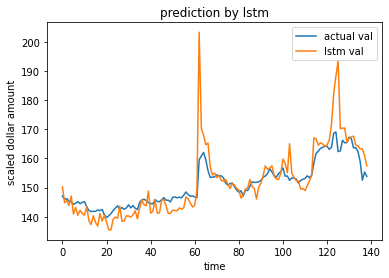

192.62047800687654
13.878777972389232
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

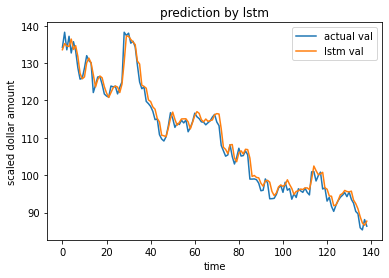

401.2864314733835
20.03213497042648
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

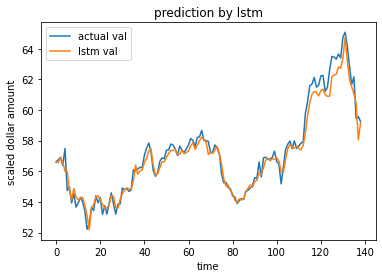

14.873280006960954
3.8565891675107102
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

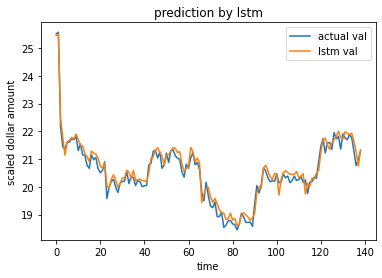

2.2962897647137557
1.5153513667508787
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

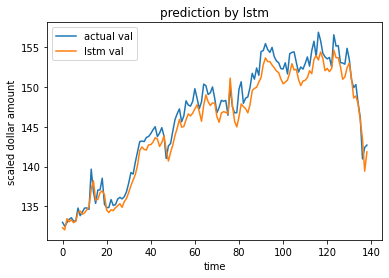

95.41943427854085
9.768287172198658
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

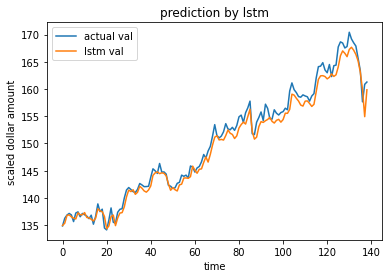

194.46078481269956
13.944919677527711
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

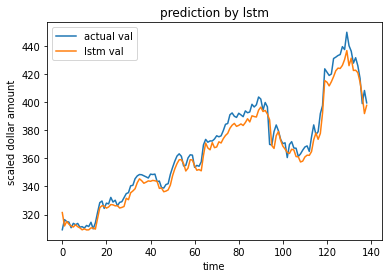

2358.573953700886
48.56515163881284
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

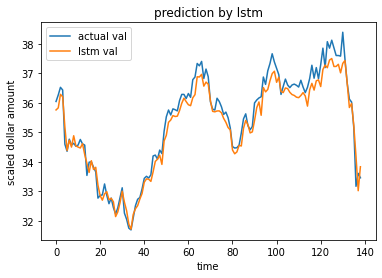

5.136041015546641
2.2662835249691597
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

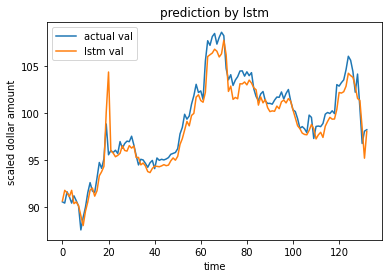

42.478011630861104
6.517515756088443
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

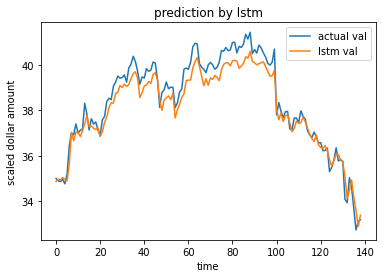

7.423933031343489
2.7246895293488924
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

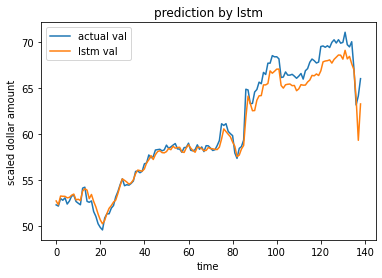

66.95212463292427
8.182427795766014
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

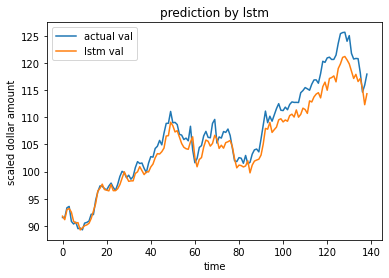

148.89345011346504
12.202190381790682
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

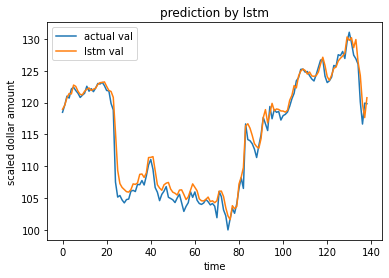

147.72010605138453
12.15401604620401
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

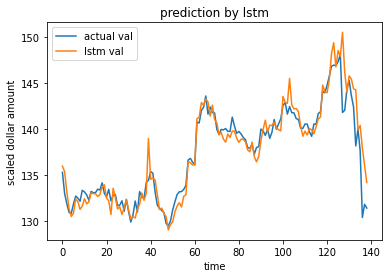

49.53149918764854
7.037861833515101
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

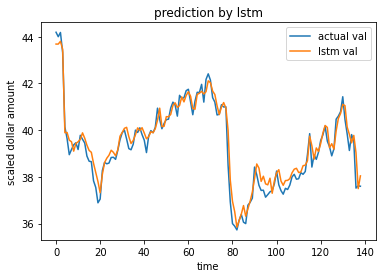

5.509540862838628
2.34724111732021
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991965

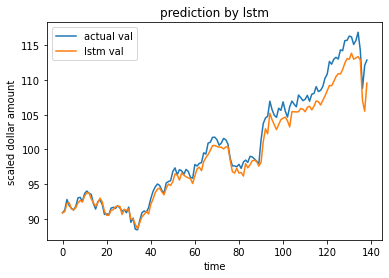

110.46501916137255
10.510234020295293
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

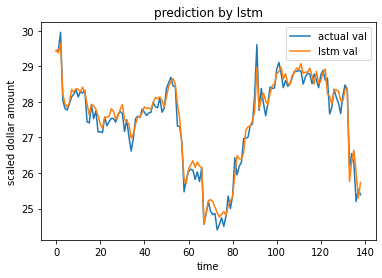

3.0837983458109175
1.7560746982434767
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

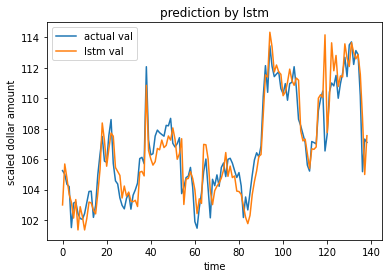

21.736431110664462
4.662234561952505
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

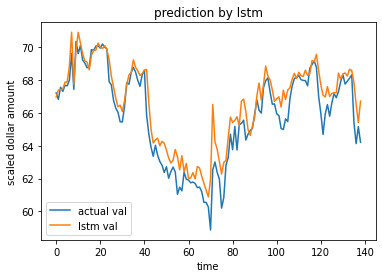

14.116460159161107
3.757187799293656
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

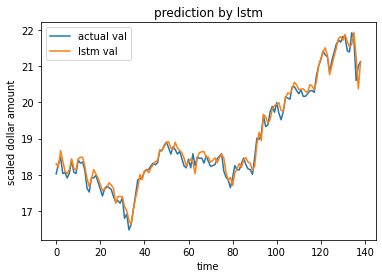

3.507546186424294
1.872844410629002
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

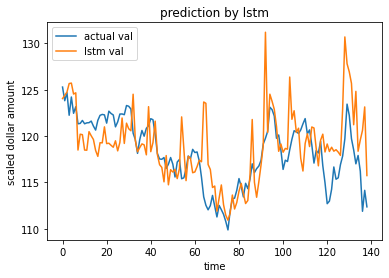

27.077941665190117
5.2036469581621425
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

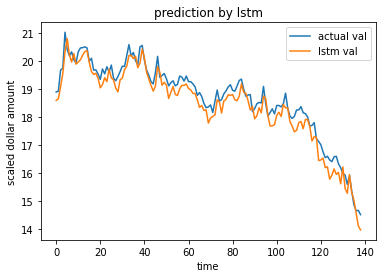

3.843576060565898
1.9605040322748377
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

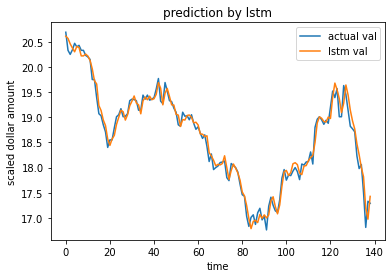

1.7629217532661055
1.3277506367033327
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

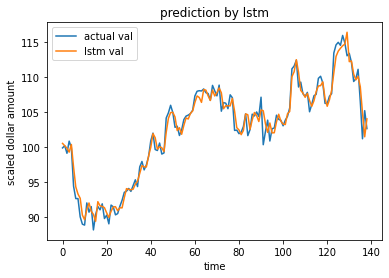

90.79509601988202
9.528646074856702
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

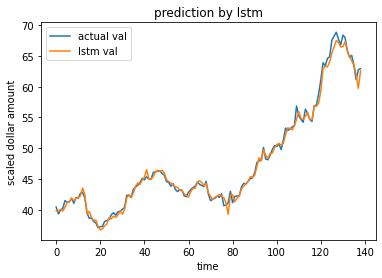

140.3062676130304
11.845094664587126
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

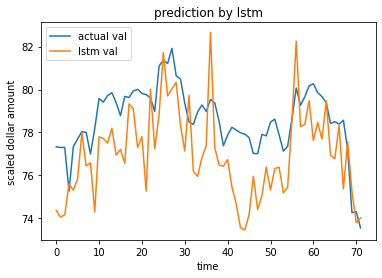

9.09776524843064
3.0162501965902364
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

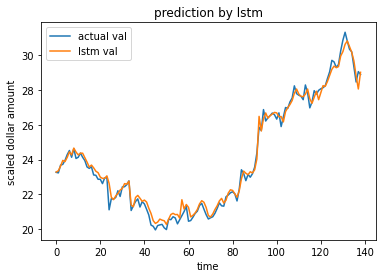

19.15521756308268
4.376667403753989
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

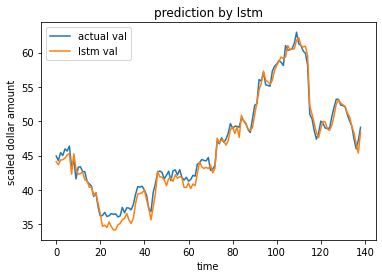

105.98122233367515
10.294718176505617
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

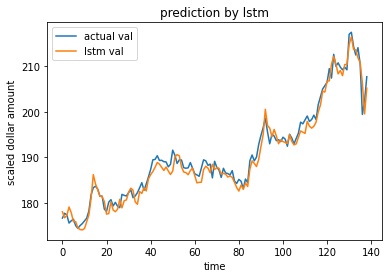

209.80096842464297
14.484507876508713
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

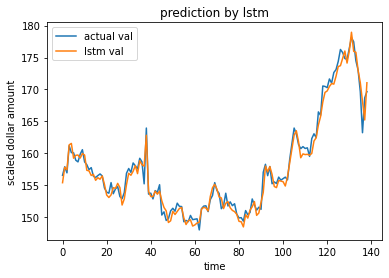

110.218365087212
10.49849346750342
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991965

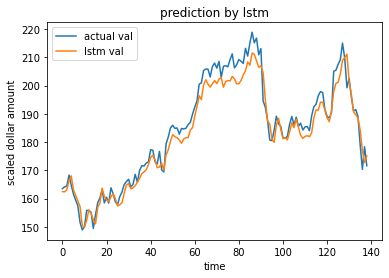

621.950581544486
24.938937057230124
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

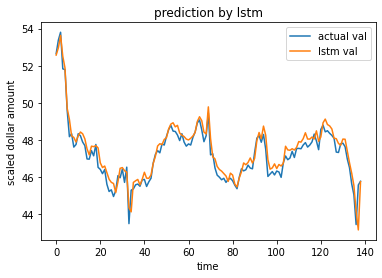

4.962207770803545
2.2276013491654076
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

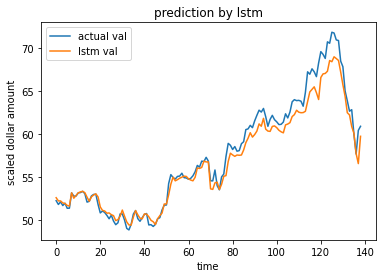

69.05522530052835
8.309947370502917
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

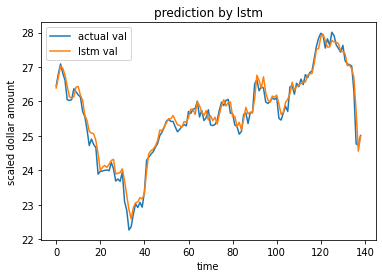

3.018357511342323
1.737342082418521
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

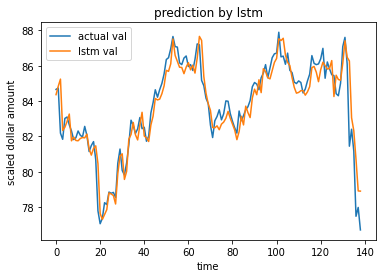

12.381168215083196
3.5186884225636113
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

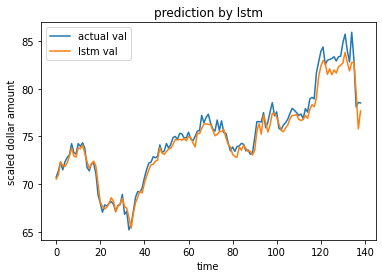

38.054032278641486
6.168795042683902
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

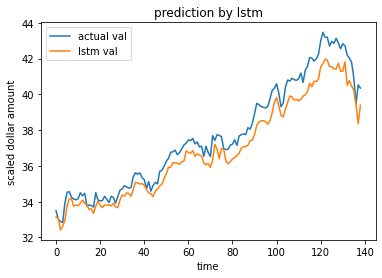

16.518803666157083
4.064333114565916
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

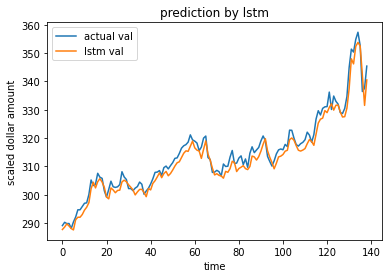

364.9163131247901
19.10278286336287
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

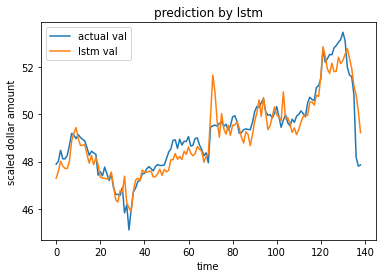

5.258710072487517
2.293187753431349
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

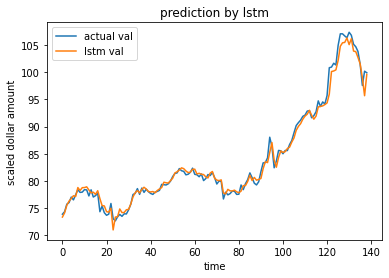

162.48778172366085
12.74706953474644
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

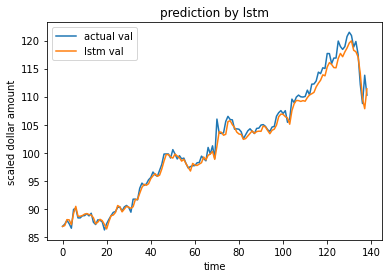

182.28162128732225
13.501171107993642
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

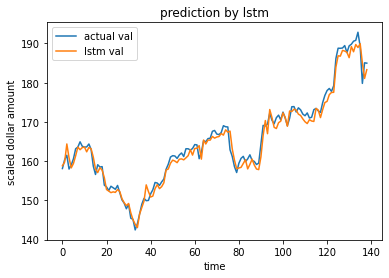

242.72359074996294
15.579588914665333
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

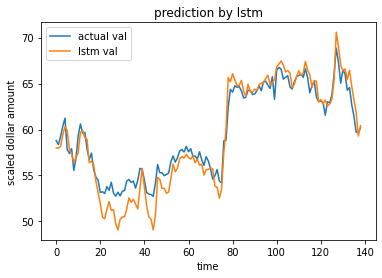

54.877336691865175
7.407923912397128
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

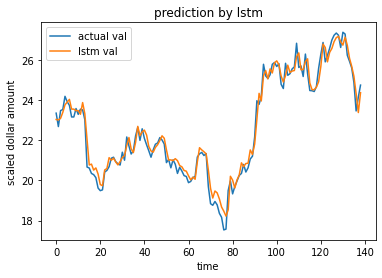

12.120741353985546
3.481485509661866
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

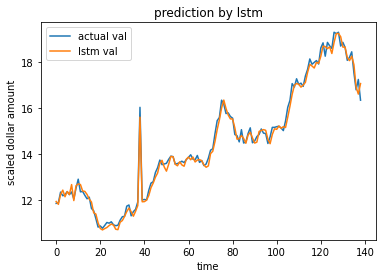

11.490070861725052
3.3897007038564704
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

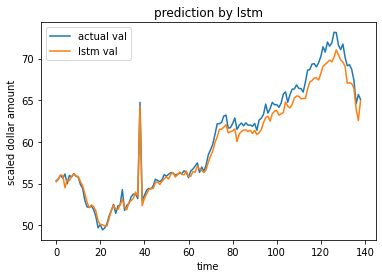

74.14989796106443
8.611033501332138
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

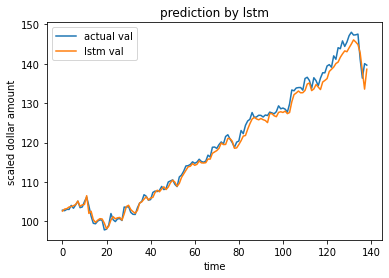

410.0563400103985
20.24984790092011
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

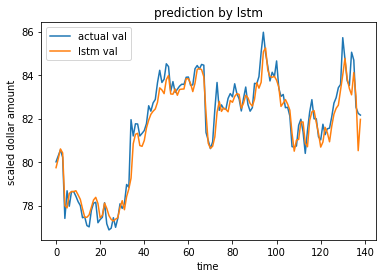

10.342684928678377
3.2160044976147617
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

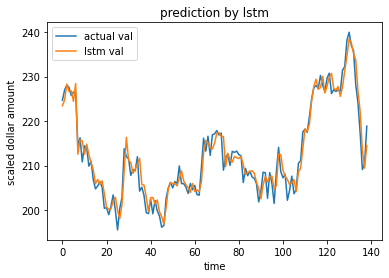

196.44191153083108
14.015773668650299
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

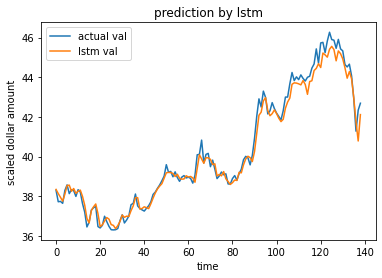

15.761011148969548
3.970013998586094
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

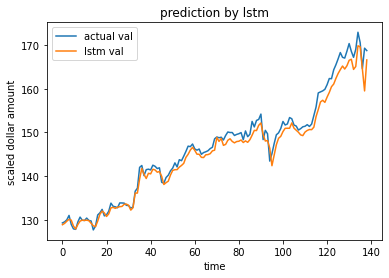

249.419181527379
15.793010527678977
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

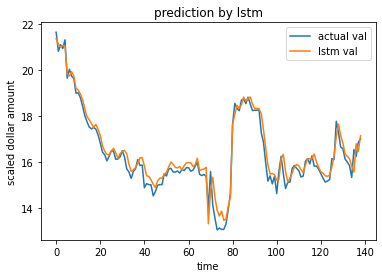

5.513982573969655
2.3481870824041375
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

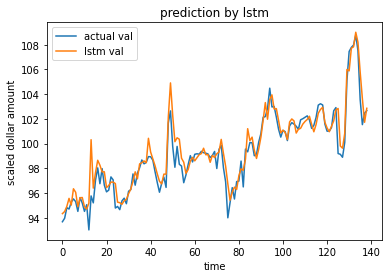

19.367379056522513
4.400838449264244
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

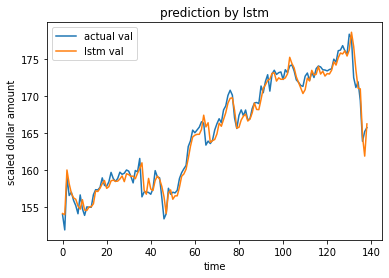

100.2123140554347
10.010610074088127
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

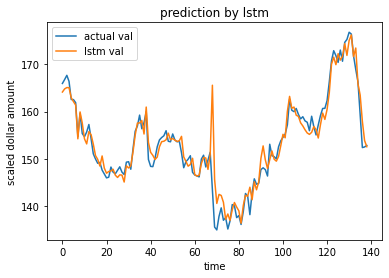

164.91924346270488
12.842088749993316
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

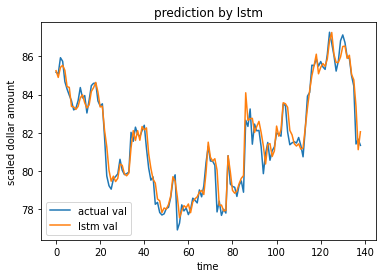

13.770945486305074
3.710922457597986
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

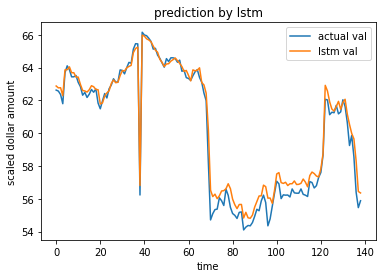

27.074243151720882
5.203291568970634
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

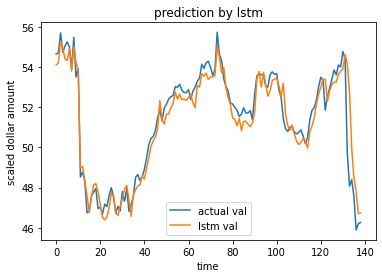

12.884536617610966
3.5895036728788794
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

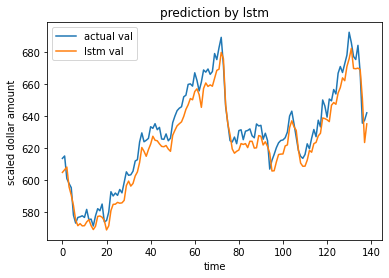

1731.6449805063949
41.6130385877599
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

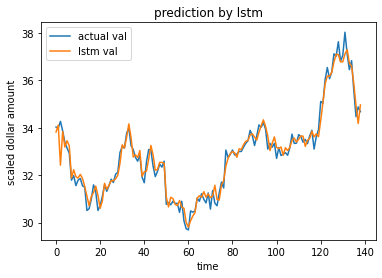

6.051114806865953
2.4599013815325916
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

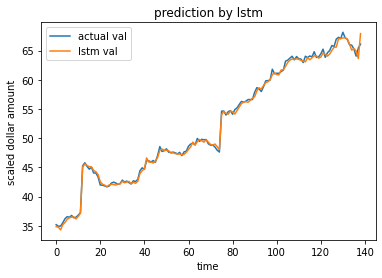

184.47466035520148
13.582144909961809
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

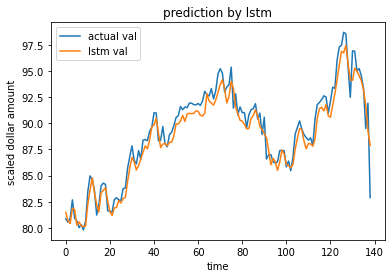

37.325329670016544
6.109445938054984
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

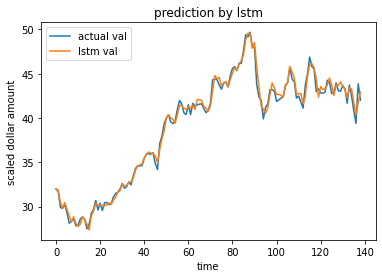

72.83759928651101
8.534494670835
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196504

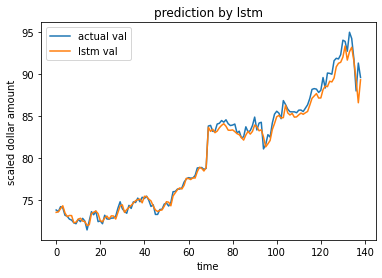

81.95700094508918
9.053010601180647
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

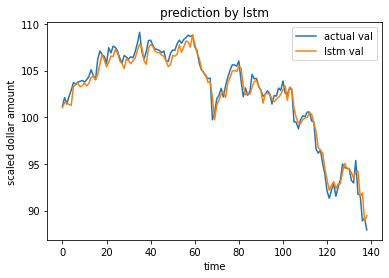

47.152487479976415
6.866766886969181
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

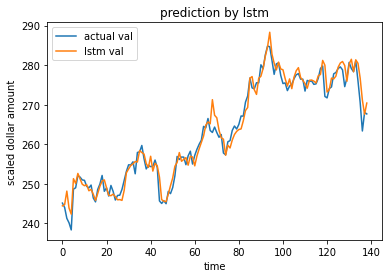

314.5638068707593
17.7359467430064
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991965

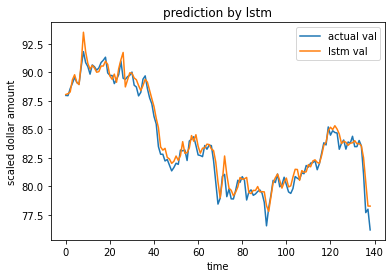

32.25163100814003
5.6790519462442
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919650

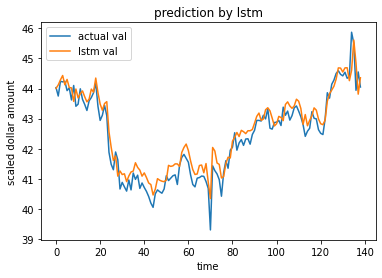

3.3640038319809653
1.8341220875342419
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

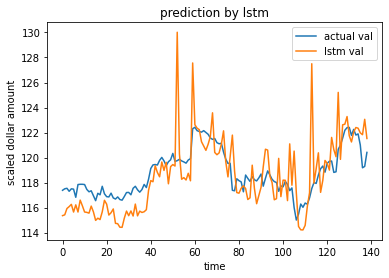

11.6833091633299
3.4180855991812
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196504

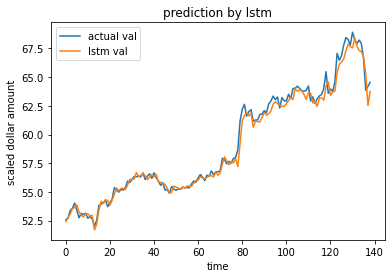

42.06377343342668
6.485659059295878
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

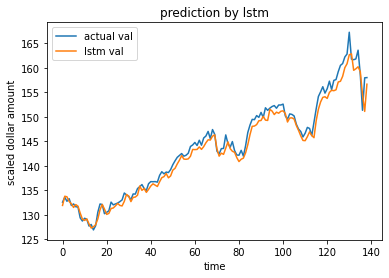

175.43365914544563
13.245137188623062
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

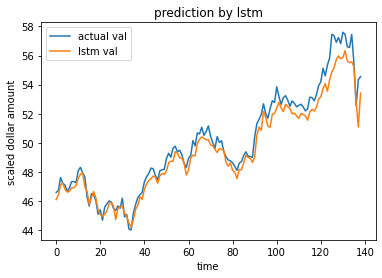

21.422203731209265
4.628412657835218
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

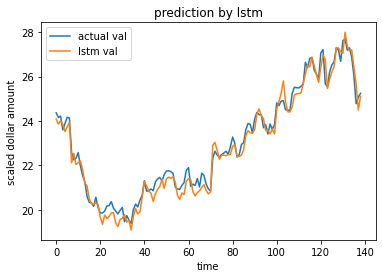

11.115648635381866
3.3340138924998297
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

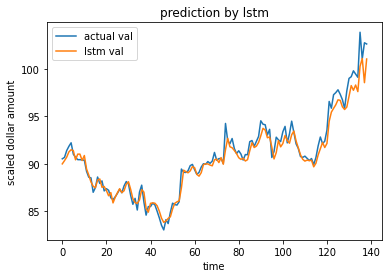

30.481456409223075
5.521001395509973
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

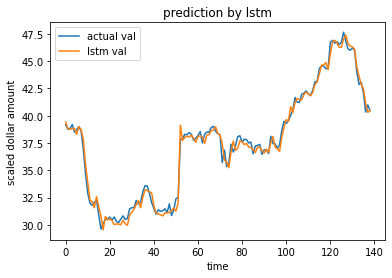

47.42898111068041
6.886870197025671
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

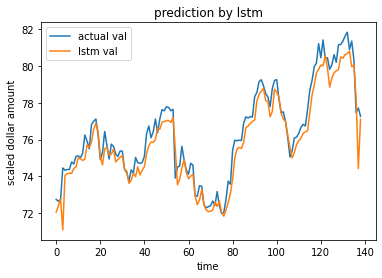

12.055130012603309
3.472049828646373
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

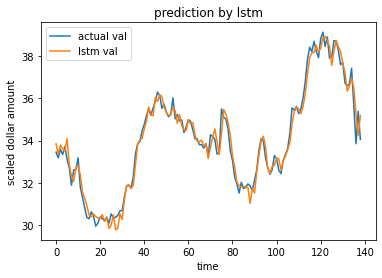

11.190732552618474
3.3452552298170724
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

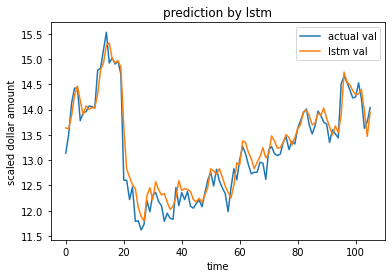

1.6733715196742824
1.2935886207269613
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

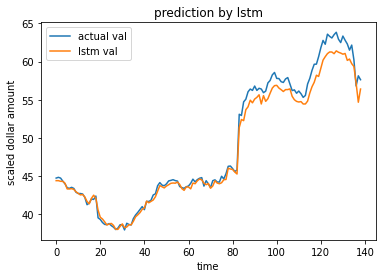

124.4050581420362
11.153701544421754
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

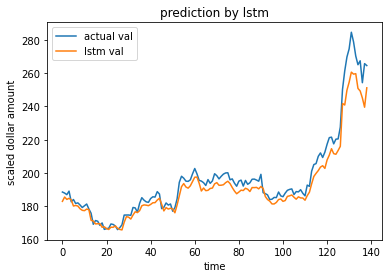

1102.6158078871908
33.20565927499695
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

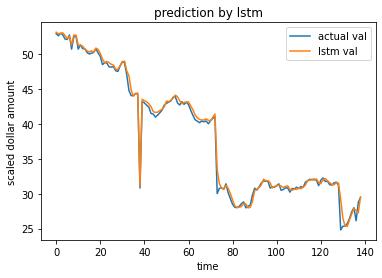

147.94385266826794
12.16321720057107
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

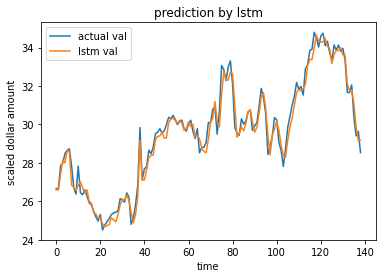

14.283679862029157
3.7793755915533396
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

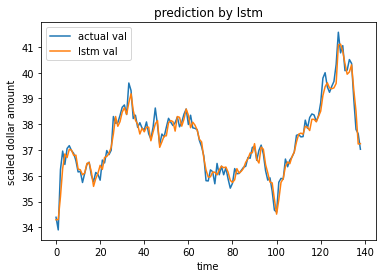

3.7290373763443645
1.9310715616839176
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

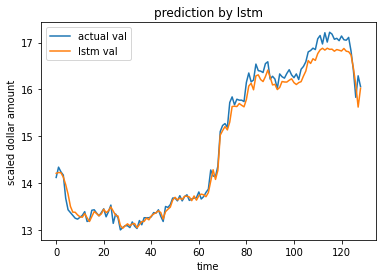

4.310024274183813
2.076059795425896
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

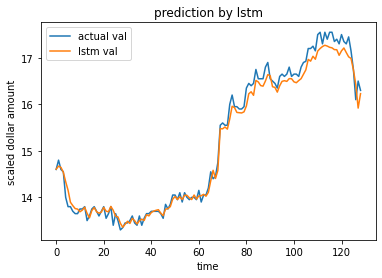

4.19573204564802
2.0483486142861573
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

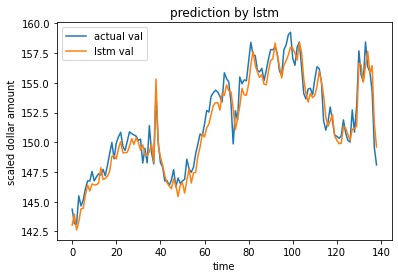

31.883832690314165
5.646577077337576
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

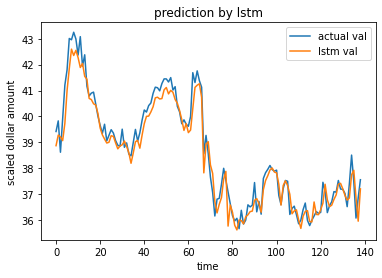

7.832714645484111
2.798698741466132
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

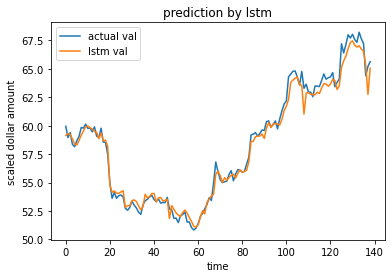

46.96279986462893
6.852940964624526
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

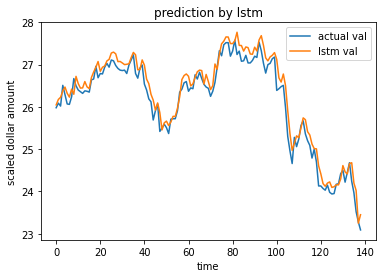

2.3190405865352215
1.522839645706409
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

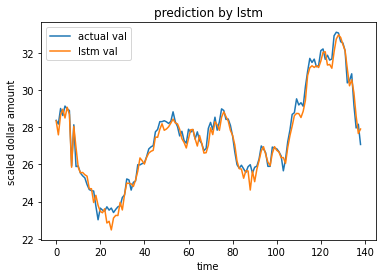

11.489842413043256
3.3896670062180525
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

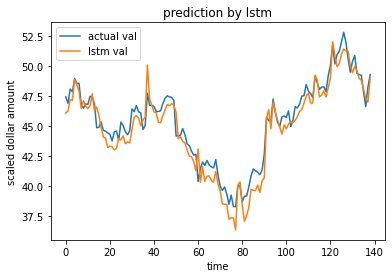

24.132987400591357
4.91253370477917
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

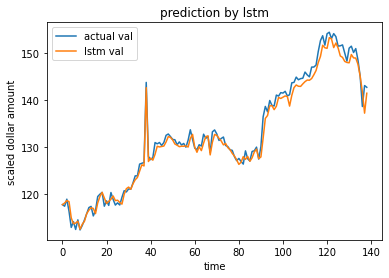

252.67579195754917
15.895779061044765
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

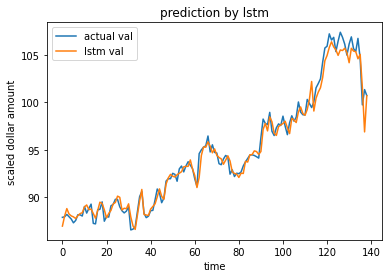

67.24379162196782
8.200231193202288
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

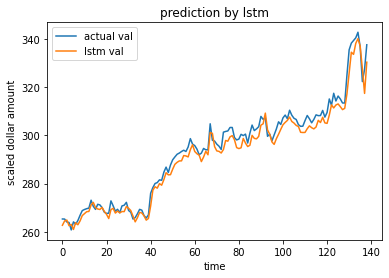

763.2593516817412
27.627148815644027
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

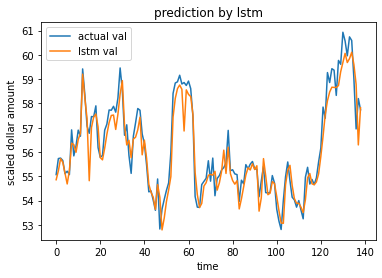

6.8994901467473015
2.6266880566118433
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

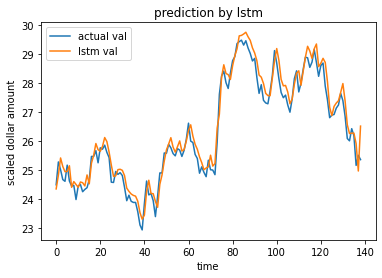

6.266197629904521
2.503237429790574
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

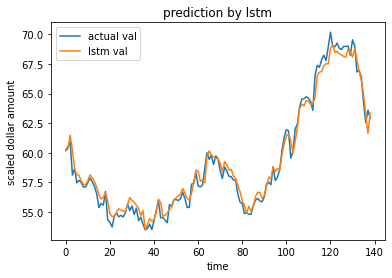

42.46362293838596
6.516411814671166
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

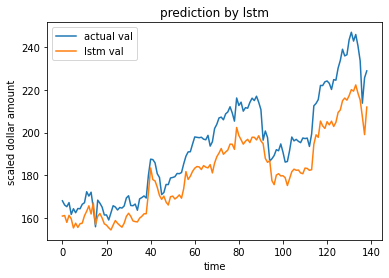

1015.9096600978369
31.87333776211454
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

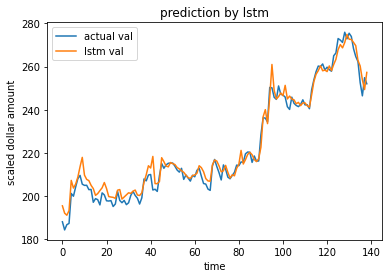

1133.8007042305137
33.67195723789328
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

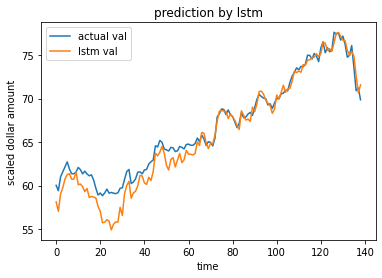

70.14977933626801
8.375546509707172
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

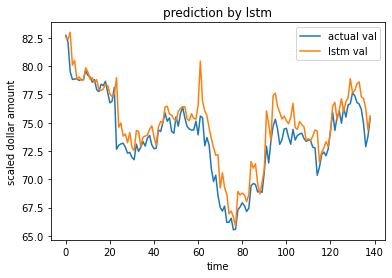

24.470763802537366
4.946793284799494
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

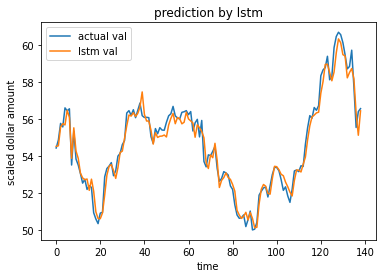

11.916475919551383
3.45202490135158
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

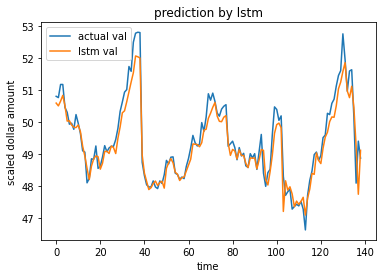

2.8704861062208233
1.694250898249968
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

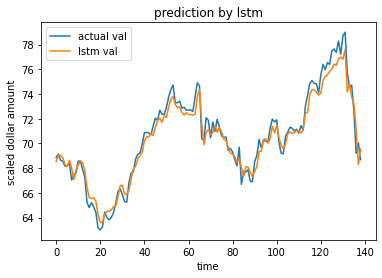

22.817450883034496
4.776761547642345
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

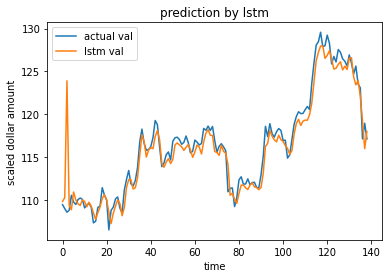

62.713154777633626
7.919163767572535
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

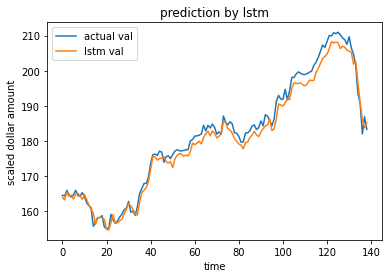

481.9074581412231
21.9523907158474
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991965

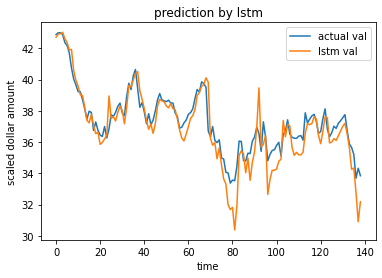

10.016855272797185
3.164941590740212
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

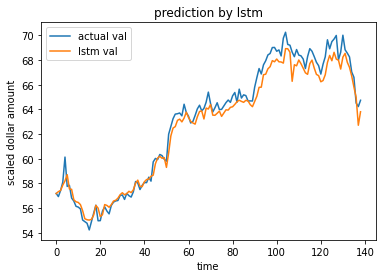

43.53946793718081
6.598444357360362
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

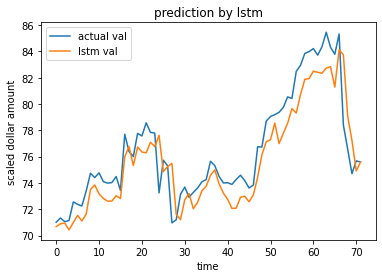

29.985681480391904
5.475918323020523
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

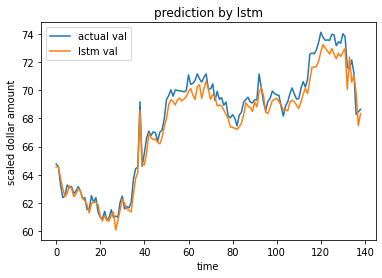

28.355662406636746
5.3250035123591
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991965

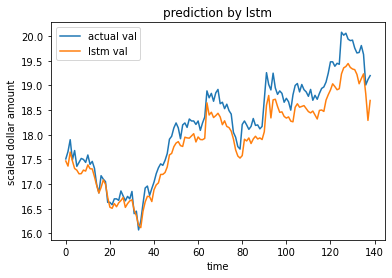

1.7106950638632352
1.3079354203718299
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

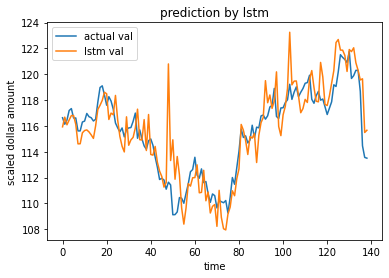

22.95193387177105
4.790817662129404
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

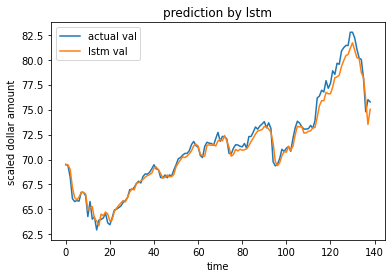

39.51648354317774
6.286213768491948
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

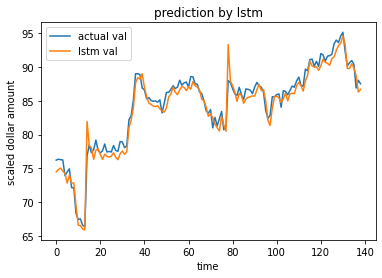

71.06722784303993
8.430138067851553
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

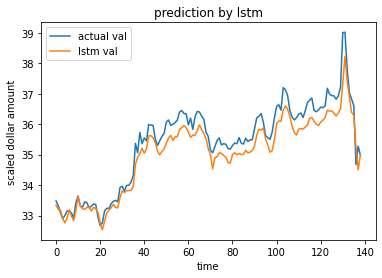

3.424682153524833
1.8505896772447514
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

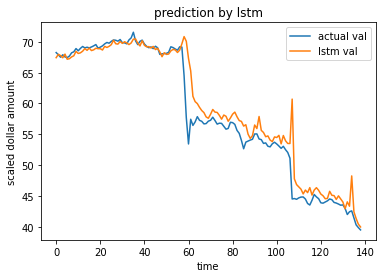

198.2369595400564
14.079664752402893
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

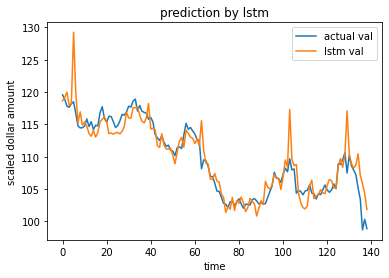

60.69183025145511
7.790496149248462
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

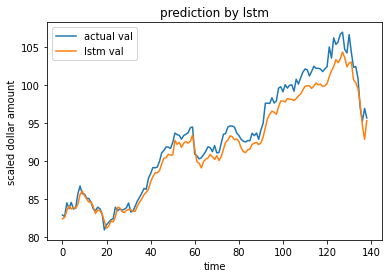

92.93403193781751
9.640229869552774
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

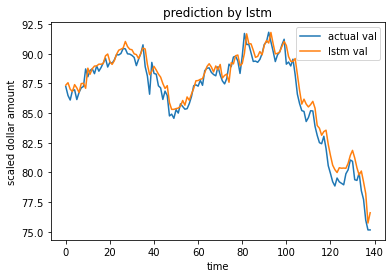

26.787939270974526
5.175706644601733
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

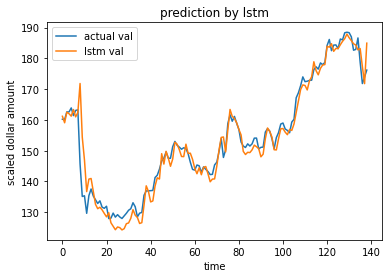

615.9025140380835
24.81738330360563
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

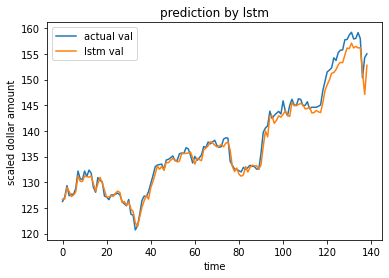

169.55417815573585
13.021297099587885
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

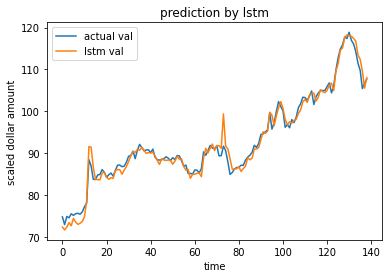

221.3134136425444
14.876606254201405
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

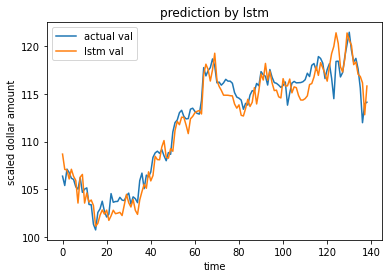

63.60217207023534
7.975096994409243
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

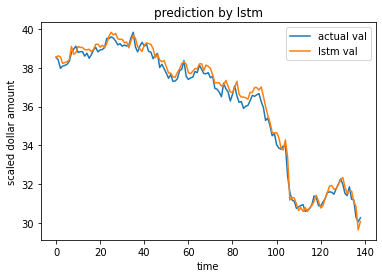

19.09241532876606
4.369486849592988
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

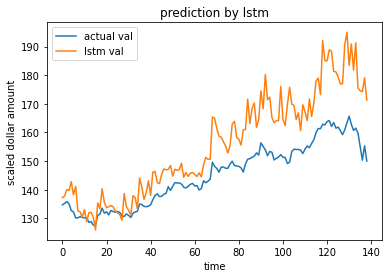

543.4269993099266
23.311520742112183
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

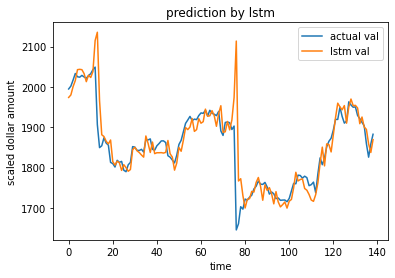

17815.868230940116
133.47609610316042
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

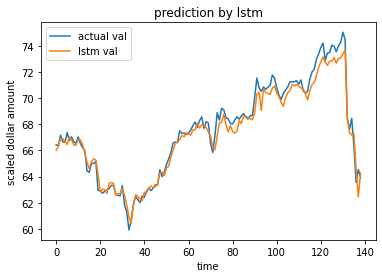

23.388441145201345
4.8361597518280295
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

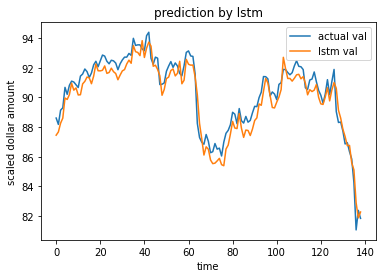

12.107054728407757
3.479519324333141
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

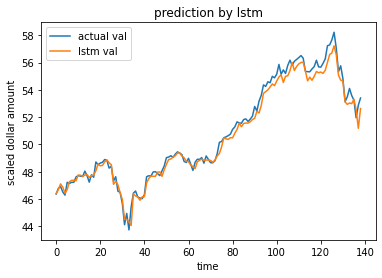

24.76919001289777
4.976865480691413
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

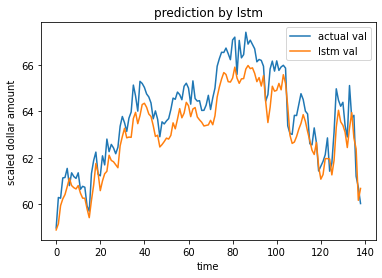

7.0369216107687995
2.6527196630569163
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

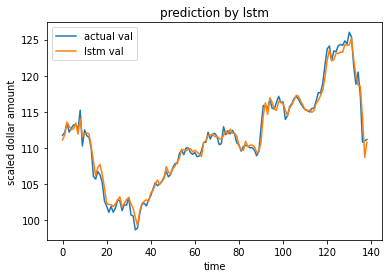

77.93209469213616
8.827915648222755
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

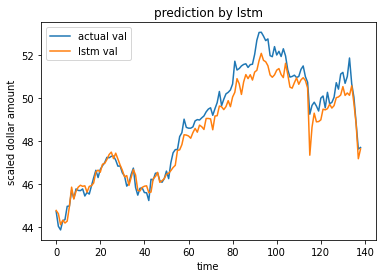

10.719062611168924
3.2739979552786718
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

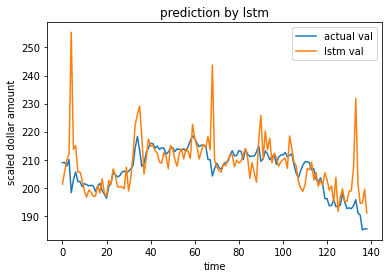

141.92193764167706
11.913099413741039
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

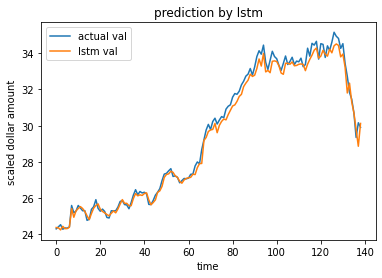

25.544764510600338
5.054182872690732
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

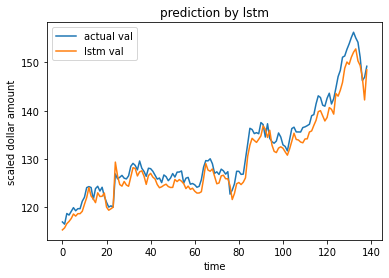

160.1940816022848
12.656780064545831
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

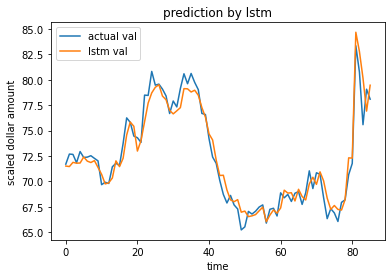

42.128773791238416
6.490668208377194
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

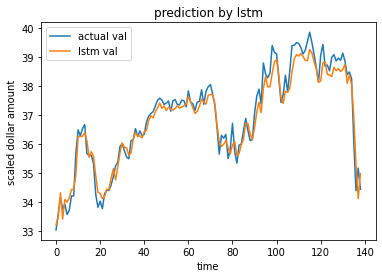

4.946730024933374
2.22412455247753
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991965

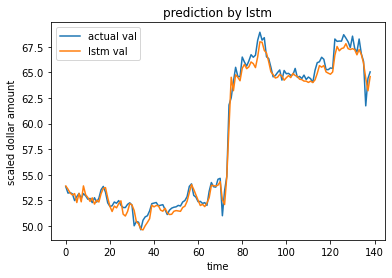

91.00064666194685
9.53942590840491
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991965

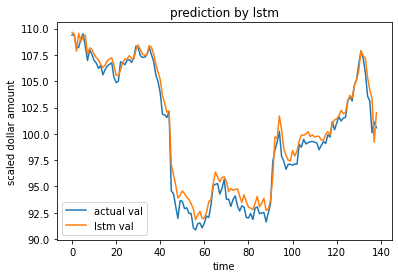

67.24114631944622
8.200069897229305
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

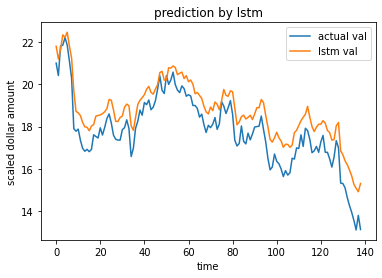

5.728126293891128
2.3933504327388264
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

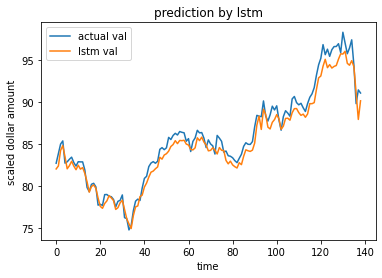

55.6466141976815
7.45966582345895
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919650

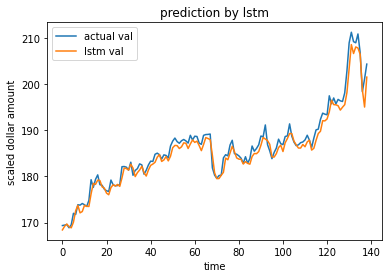

131.09938544649617
11.449863992489002
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

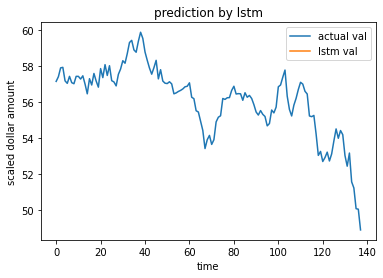

nan
nan
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919650469], ['ALLE', 15.59247944

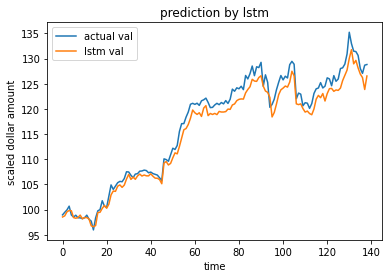

214.31516103422555
14.639506857617354
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

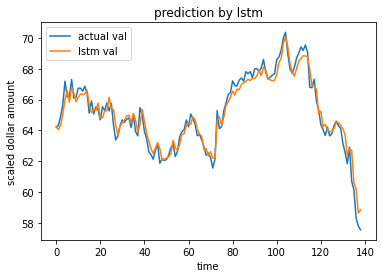

10.453822964853494
3.23323722681363
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

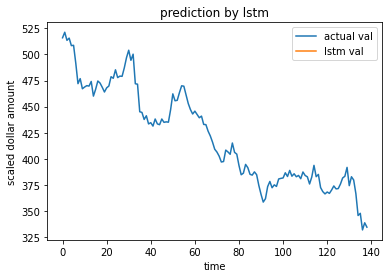

nan
nan
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919650469], ['ALLE', 15.59247944

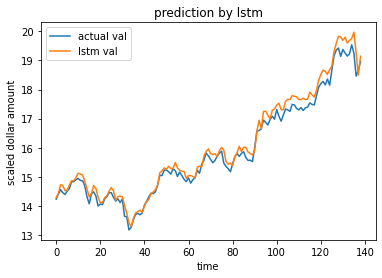

5.817598284332878
2.4119697934121973
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

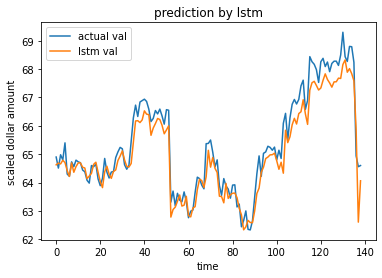

5.302024289158375
2.3026124921832536
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

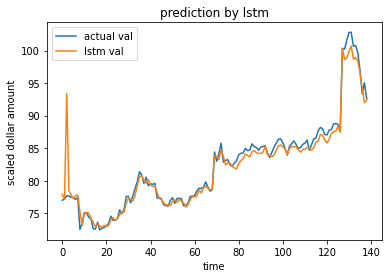

90.14903101326372
9.494684355641514
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

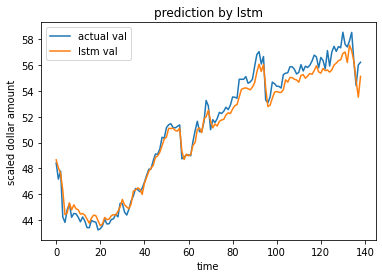

41.35572461360611
6.430841672254582
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

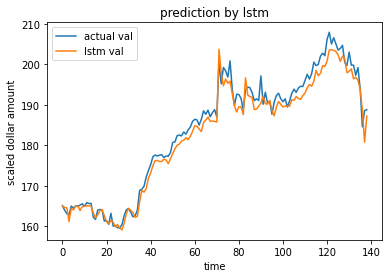

391.35983696936836
19.78281670969451
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

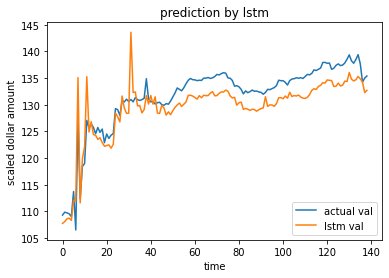

83.15543513217924
9.11896020016423
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991965

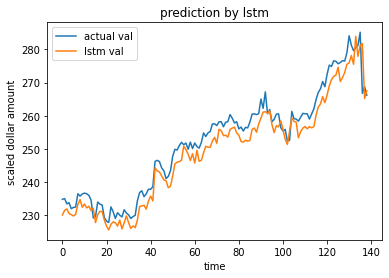

464.82917634673794
21.55989741039456
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

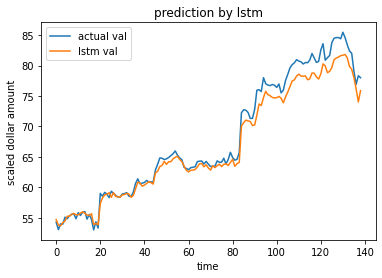

172.9847270822433
13.152365835933978
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

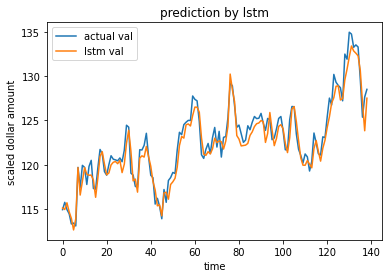

37.89910933149902
6.156225250224281
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

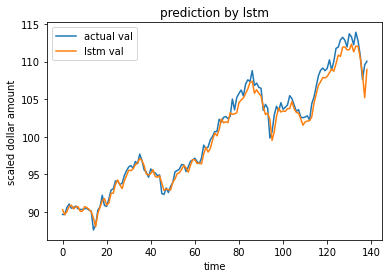

94.31899543590637
9.711796715124672
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

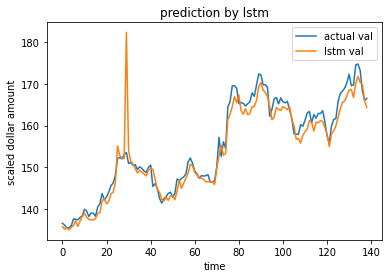

235.70376535927437
15.352646851903888
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

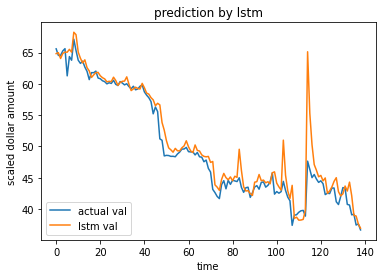

146.9715951896704
12.12318420175452
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

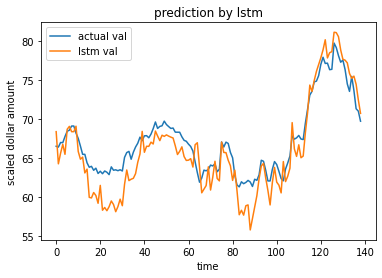

58.26925809115237
7.633430296475653
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

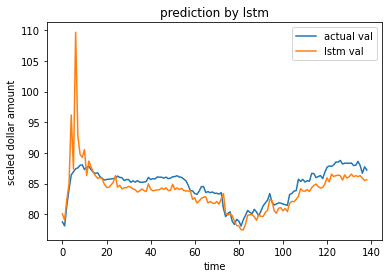

21.165545795077215
4.600602764320912
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

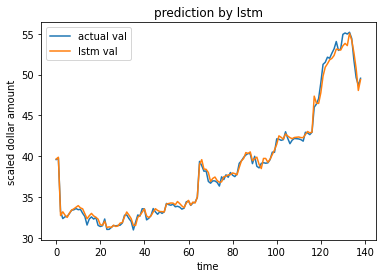

88.79891276974713
9.423317503392695
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

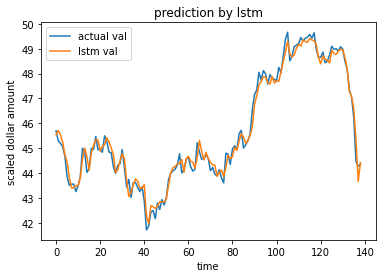

9.26246366745305
3.04342958969861
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919650

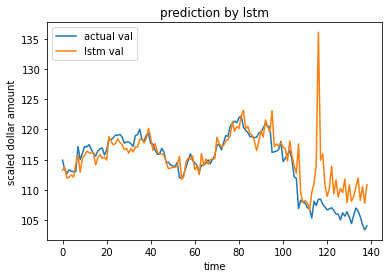

40.70808490082249
6.3802887787954
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919650

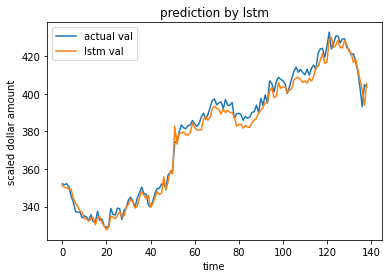

1976.5845753630315
44.45879637780393
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

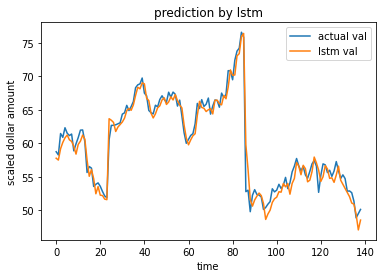

84.30365423773338
9.181702142725682
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

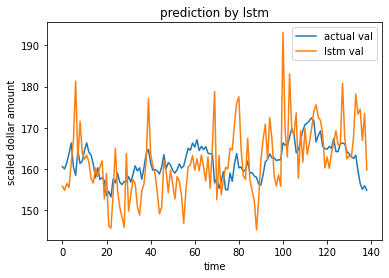

86.25621320619283
9.28742231225612
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991965

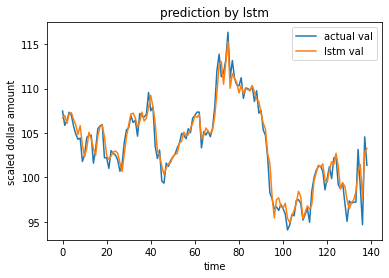

43.3297448966819
6.582533319071154
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991965

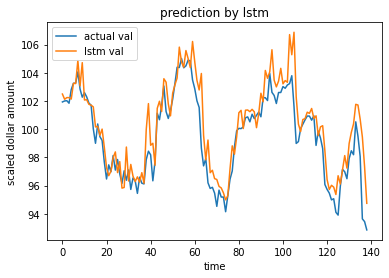

18.96388373077564
4.354754152736482
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

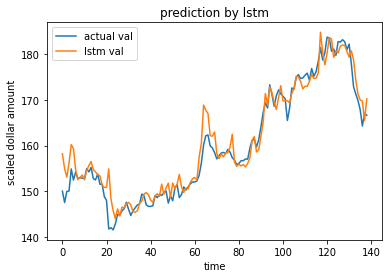

272.82123977555455
16.51730122554997
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

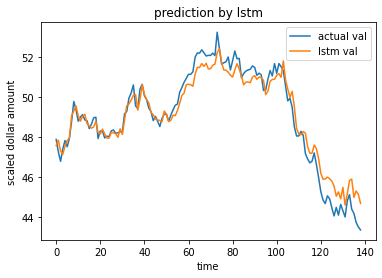

9.69158456307875
3.1131309903501894
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

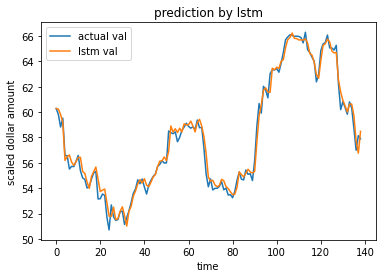

38.33155056857082
6.191247900752385
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

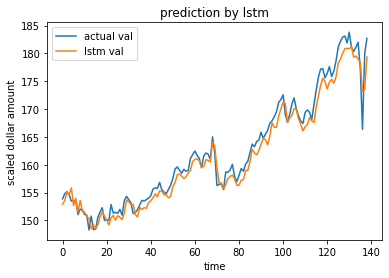

181.40147016331005
13.468536303671236
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

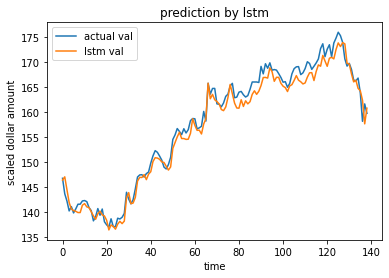

261.83743297997927
16.181391565003896
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

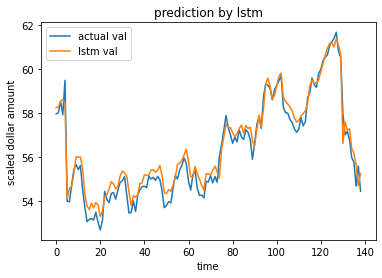

9.114749448785293
3.019064333329996
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

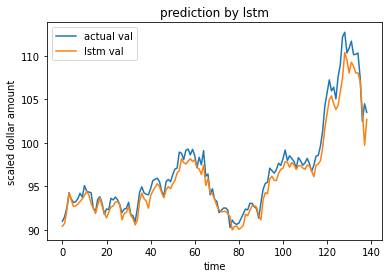

51.21230395960078
7.156277241666982
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

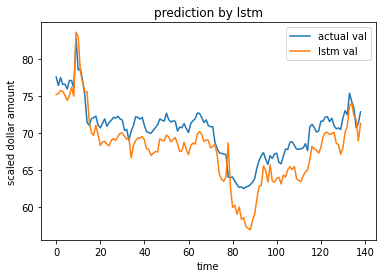

40.209838169059395
6.341122784575252
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

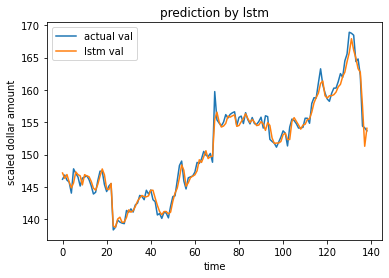

100.90613653885205
10.045204653905865
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

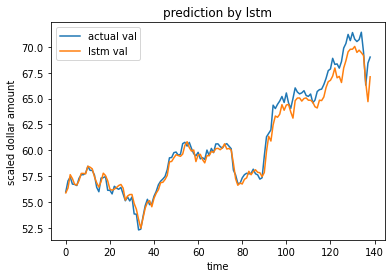

42.86768124498078
6.547341540272722
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

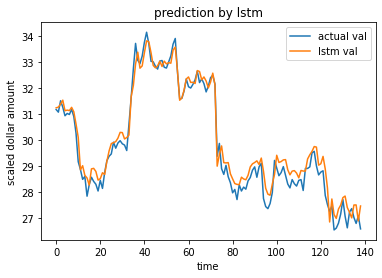

8.039784345499072
2.8354513477573677
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

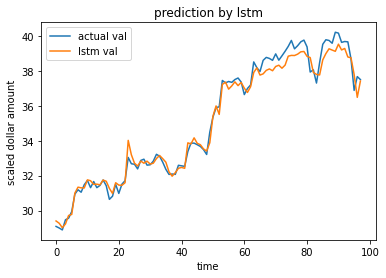

22.07441692245386
4.698341933326464
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

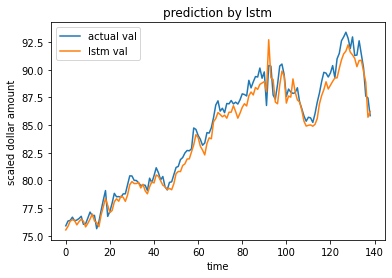

49.72141351139655
7.051341256200592
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

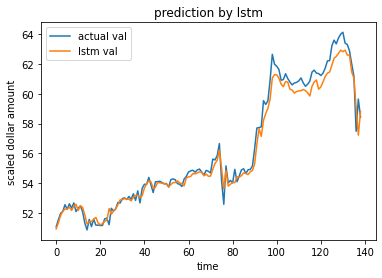

28.76548828392517
5.3633467428393224
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

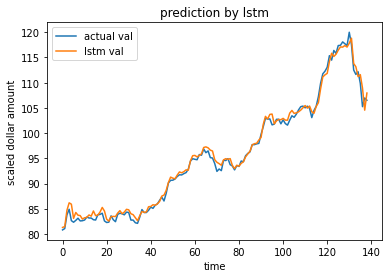

228.85370653810742
15.127911506156671
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

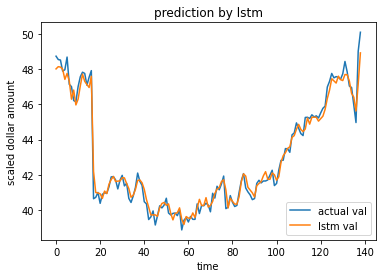

17.301266164517553
4.159479073696315
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

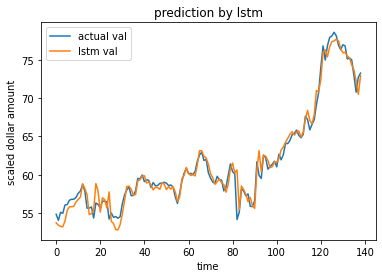

84.89586560031948
9.21389524578609
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991965

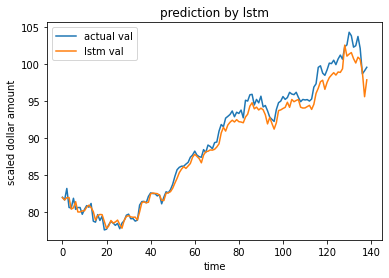

115.53808428767582
10.748864325484615
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

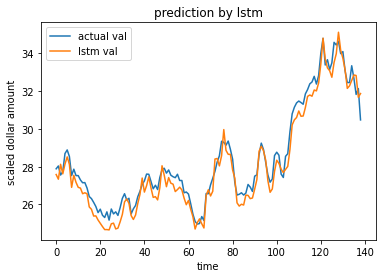

14.236860292268746
3.773176419446717
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

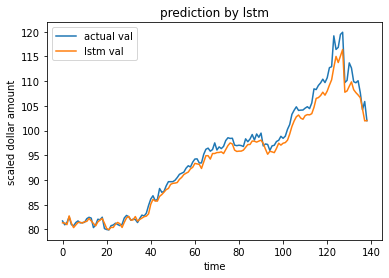

214.17982102309747
14.634883703777678
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

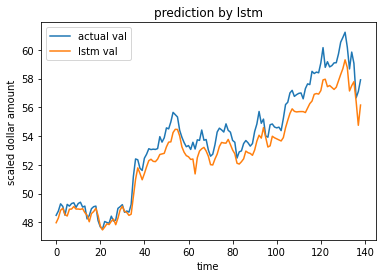

22.881037683389735
4.783412765316175
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

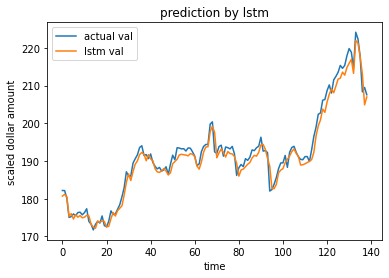

262.10843782961547
16.189763365460763
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

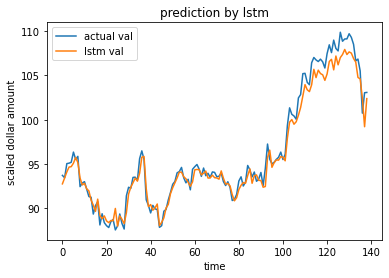

72.95273606310134
8.54123738477636
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991965

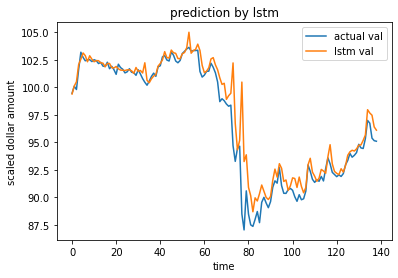

52.138533749493035
7.220701749102578
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

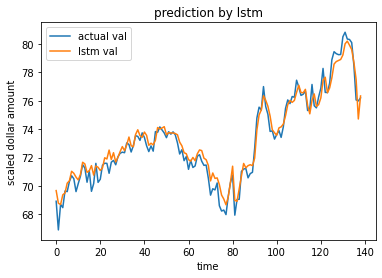

17.23688714069709
4.151733028591445
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

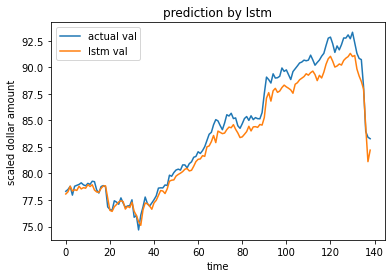

54.76298657732891
7.400201793014087
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

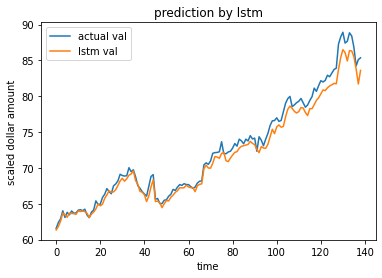

95.37901260108934
9.766217927175767
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

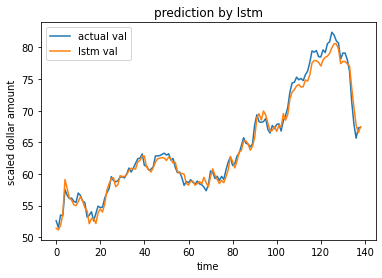

124.85413847926571
11.17381485792859
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

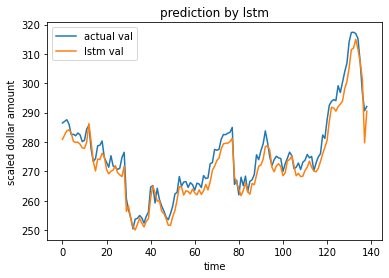

383.64747658451654
19.586921059332337
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

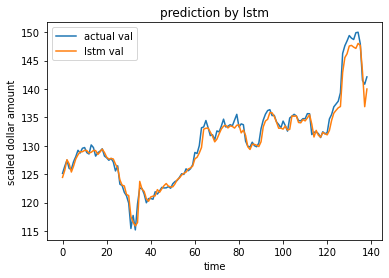

94.41609214149743
9.716794334629988
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

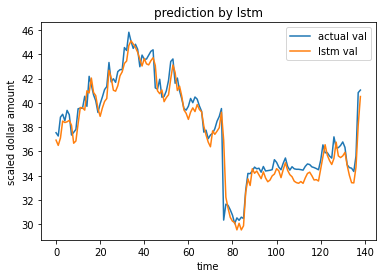

29.9033229692327
5.4683930883974226
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

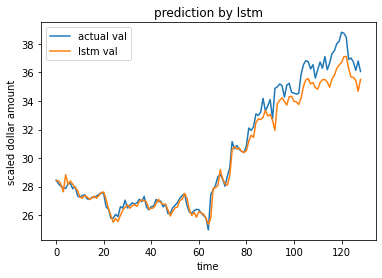

31.73858951342147
5.633701226850912
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

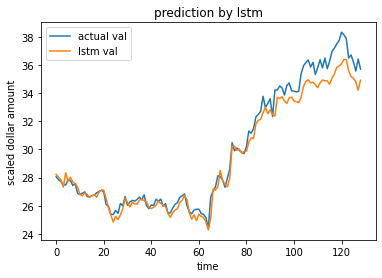

32.54936634005063
5.705205197015322
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

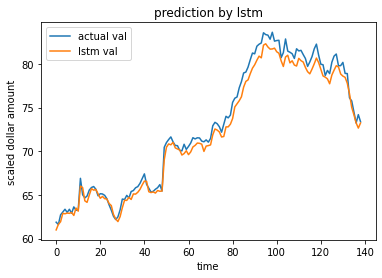

94.71248569010434
9.732033995527571
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

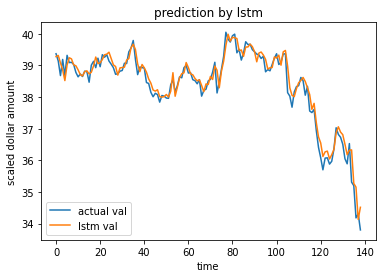

2.7312901424804332
1.6526615329463057
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

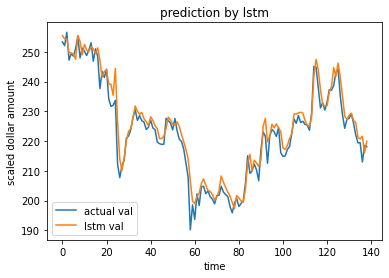

494.712178422566
22.242126211820803
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

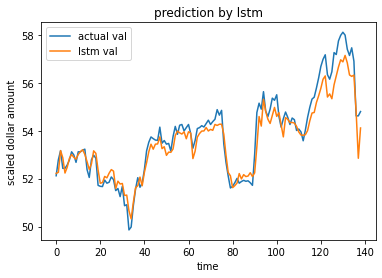

5.194120142280489
2.2790612414501914
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

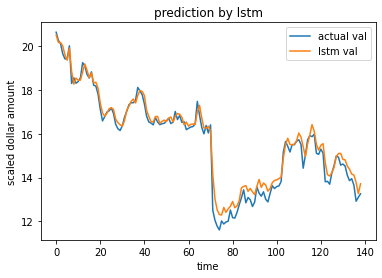

8.567899062945038
2.927097378452763
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

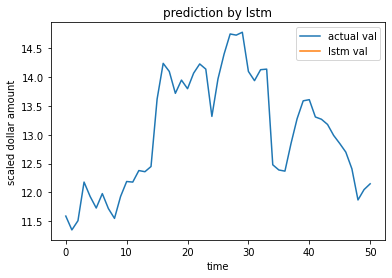

nan
nan
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919650469], ['ALLE', 15.59247944

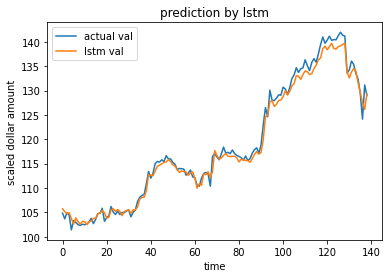

288.64691663917847
16.989612021443527
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

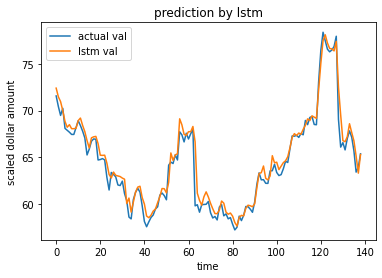

46.60969186314657
6.827129108428123
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

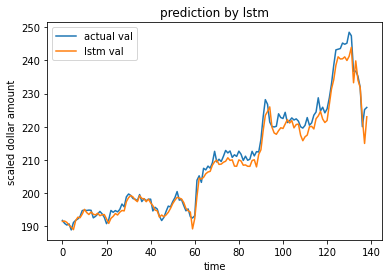

465.1592082335513
21.567549889441576
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

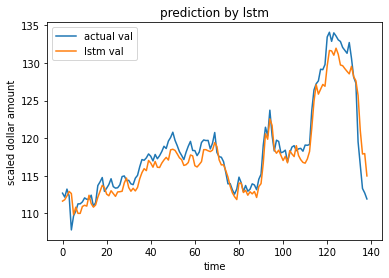

66.9461489232991
8.182062632570048
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991965

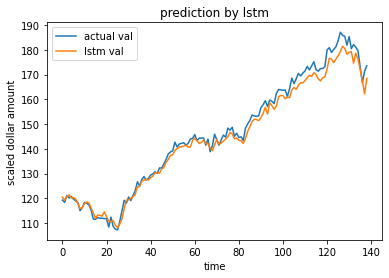

970.3616911018034
31.150629064303075
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

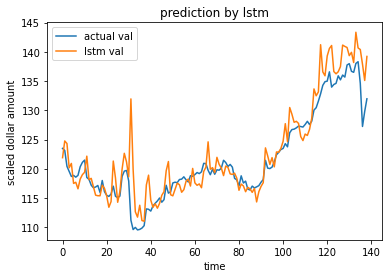

122.83509782598794
11.083099648834162
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

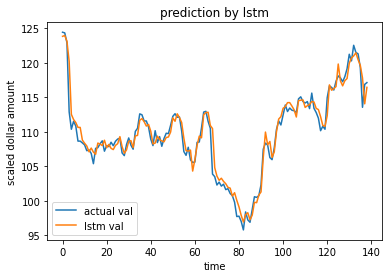

67.834085821311
8.236145082580261
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919650

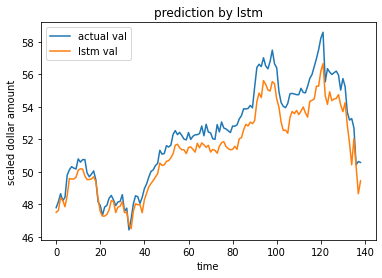

15.824079447717127
3.977949150971783
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

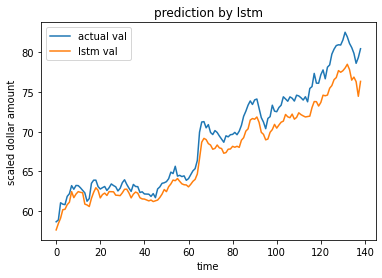

73.00363131687874
8.54421624942152
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991965

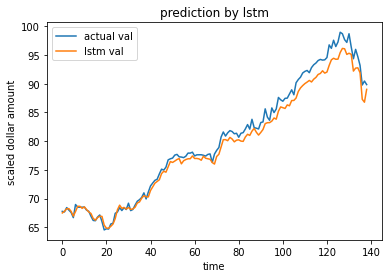

188.1273916536522
13.71595390972324
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

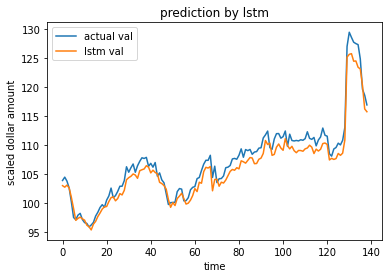

84.51425818035604
9.193163665482958
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

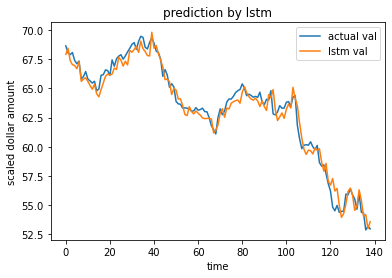

34.35533587410272
5.861342497594107
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

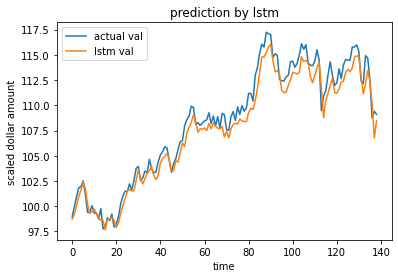

59.70670303472053
7.72701126145941
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991965

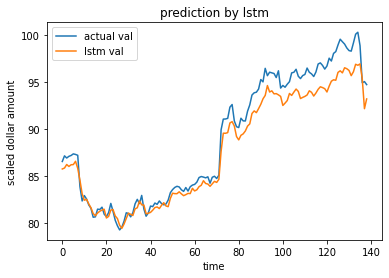

77.37342266737728
8.796216383615018
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

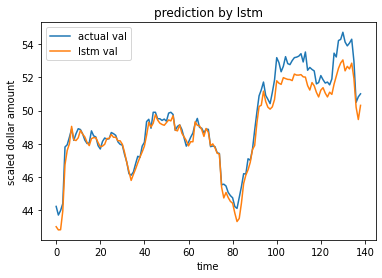

13.000808749793965
3.6056634271370873
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

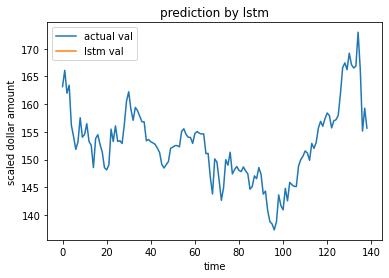

nan
nan
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919650469], ['ALLE', 15.59247944

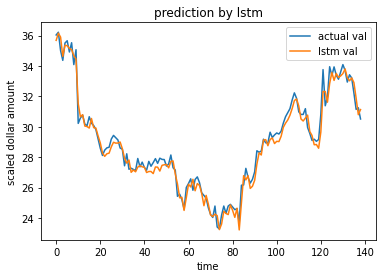

19.420340905949615
4.406851586558097
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

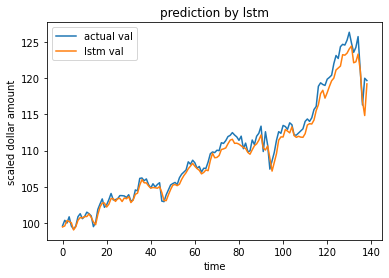

89.74878492935512
9.473583531555265
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

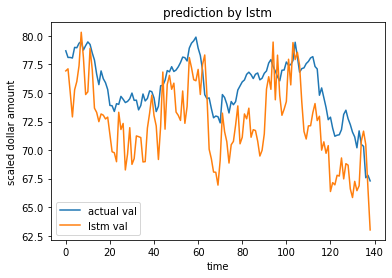

27.8281893067285
5.275243056649475
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991965

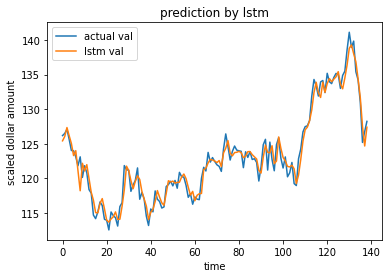

78.11872419243032
8.838479744414778
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

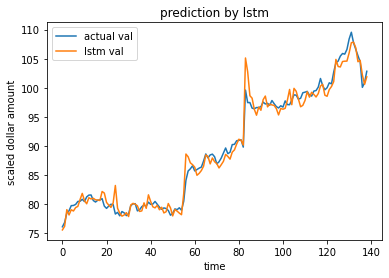

182.24519967370466
13.499822208966481
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

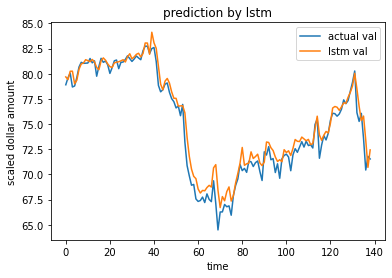

48.47458023559043
6.962368866671058
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

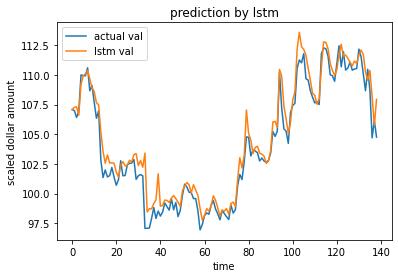

45.77759002332506
6.7659138350503
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919650

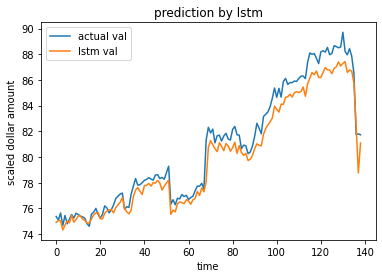

38.45619047437339
6.201305545961543
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

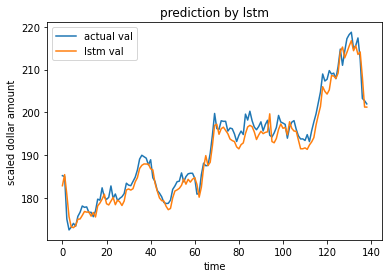

249.82447231971767
15.805836653582045
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

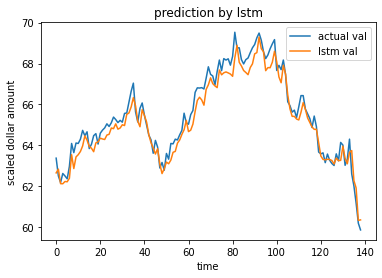

8.196886480763787
2.863020517000147
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

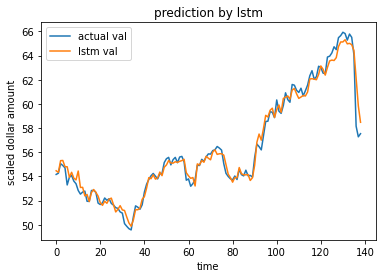

35.37333545365983
5.947548692836388
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

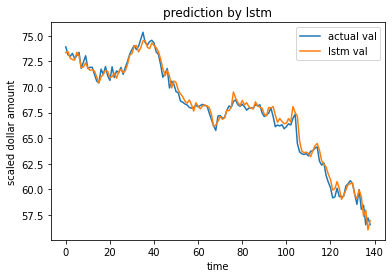

41.89372909723965
6.472536527300534
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

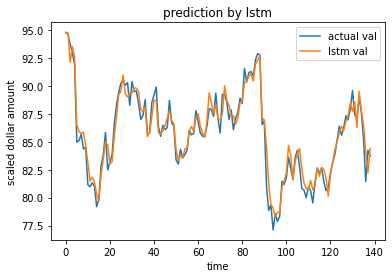

26.651050381109016
5.162465533164267
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

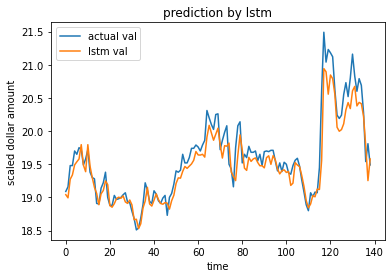

0.6567246333816816
0.8103854844342177
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

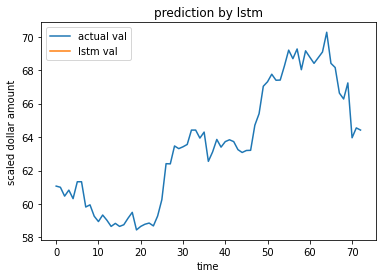

nan
nan
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919650469], ['ALLE', 15.59247944

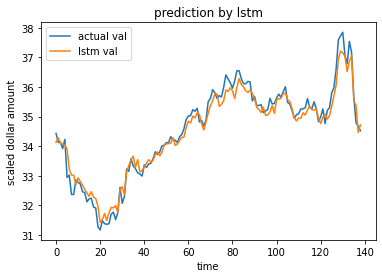

4.316500610807539
2.077618976330246
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

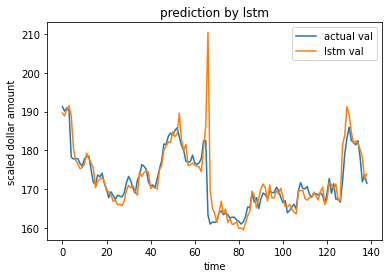

116.69723541207964
10.802649462612385
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

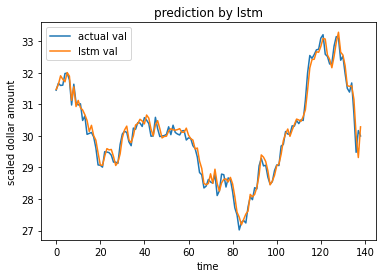

3.9595544661754354
1.9898629264789662
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

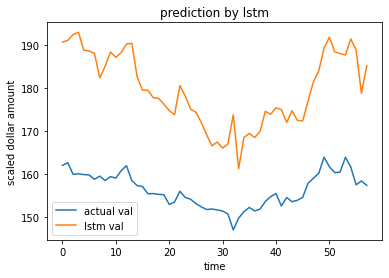

628.5263051905483
25.07042690483248
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

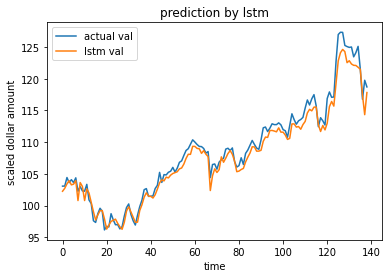

108.62490259101595
10.422327119747104
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

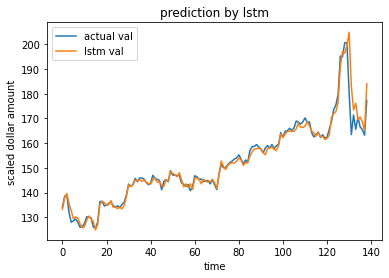

488.08029817894334
22.09253942350094
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

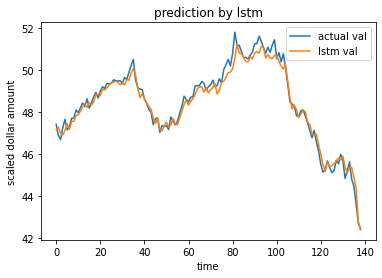

6.618802488709782
2.5727033425386967
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

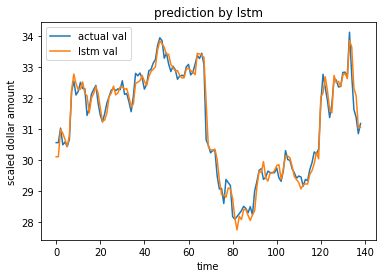

5.360485159896386
2.315272156766108
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

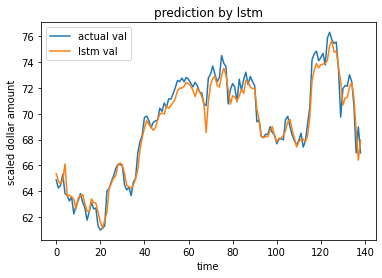

28.215275126321337
5.3118052605796215
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

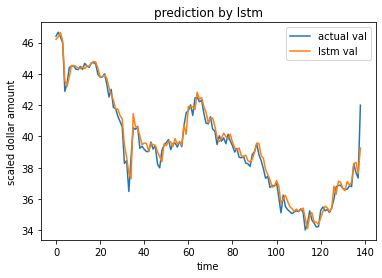

19.577033758450533
4.424594191386429
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

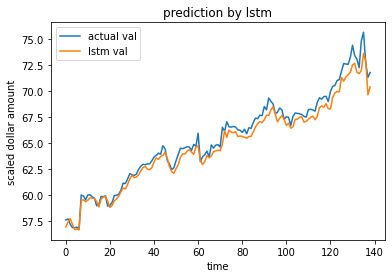

34.618680440902786
5.8837641387892825
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991

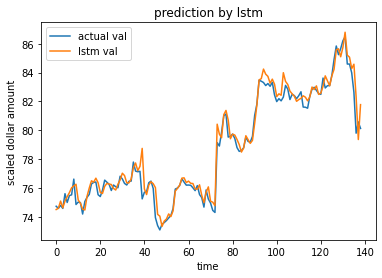

25.90863262878815
5.090052320830126
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

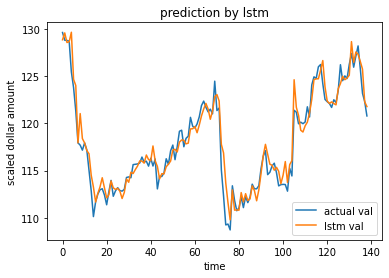

49.9524622380609
7.067705585128805
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.9203991965

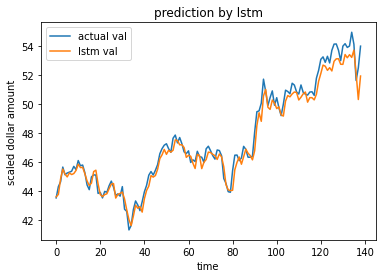

21.716240998092676
4.660068776111858
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.92039919

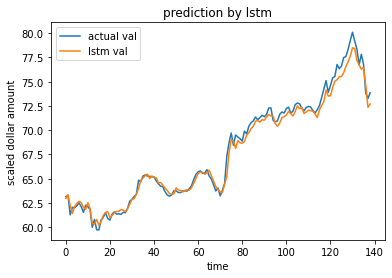

54.12309069622281
7.356839722069716
OUTPUT=[['ABT', 24.356421657662043, 4.935222554015375], ['ABBV', 283.9735890286591, 16.851515926724787], ['ACN', 219.9575514881682, 14.8309659661186], ['ATVI', 17.56439060732873, 4.190989215844957], ['AYI', 326.0021982318947, 18.05553095956734], ['ADBE', 567.644808121066, 23.825297650209244], ['AMD', 2.8406614277790627, 1.6854261857996222], ['AAP', 238.38550036923453, 15.439737704029643], ['AES', 0.18346220506927632, 0.42832488261747803], ['AET', 296.9162308016248, 17.231257377267184], ['AMG', 236.63064572619717, 15.382803571722457], ['AFL', 22.274702591423402, 4.7196083091103445], ['A', 25.15515220315772, 5.015491222518261], ['APD', 129.41479073475892, 11.376062180506878], ['AKAM', 109.97762683585704, 10.48702182871081], ['ALK', 98.42806735729606, 9.92109204459348], ['ALB', 203.85463278637476, 14.277767079847422], ['ARE', 28.86854628939616, 5.372945773911752], ['ALXN', 281.03060399636126, 16.76396743006742], ['ALGN', 2296.3646591523675, 47.920399196

In [ ]:
df=[]
OUTPUT=[]
for stockName in StockChoices:
    with open('/content/drive/My Drive/individual_stocks_5yr/{}_data.csv'.format(stockName),'r') as f:
        data=(pandas.read_csv(f, na_values=['null'], index_col='date', parse_dates=True, infer_datetime_format=True))
        print("Dataframe Shape: ", data.shape)
        print(len(data['open']))
        output_var = pandas.DataFrame(data['close'])
        features = ['open', 'high', 'low', 'volume']
        scaler = MinMaxScaler()
        feature_transform = scaler.fit_transform(data[features])
        feature_transform= pandas.DataFrame(columns=features, data=feature_transform, index=data.index)
        timesplit = TimeSeriesSplit(n_splits=8)
        print(timesplit.index)
        for train_index, test_index in timesplit.split(feature_transform):
            X_train, X_test = feature_transform[:len(train_index)], feature_transform[len(train_index): (len(train_index)+len(test_index))]
            y_train, y_test = output_var[:len(train_index)].values.ravel(), output_var[len(train_index): (len(train_index)+len(test_index))].values.ravel()
        train_X = np.array(X_train)
        test_X = np.array(X_test)
        X_train = train_X.reshape(X_train.shape[0], 1, X_train.shape[1])
        X_test = test_X.reshape(X_test.shape[0], 1, X_test.shape[1])
        lstm = Sequential()
        lstm.add(LSTM(32, input_shape=(1, train_X.shape[1]), activation='relu', return_sequences=False)) ###
        lstm.add(Dense(1))
        lstm.compile(loss='mean_squared_error', optimizer='adam')
    #   plot_model(lstm, show_shapes=True, show_layer_names=True)
        history=lstm.fit(X_train, y_train, epochs=70, batch_size=8, verbose=0, shuffle=False)
        y_pred= lstm.predict(X_test)
        print(stockName)
        plt.plot(y_test, label='actual val')
        #plt.plot(y_pred, label='lstm val')
        plt.title("prediction by lstm")
        plt.xlabel('time')
        plt.ylabel('scaled dollar amount')
        plt.legend()
        plt.show()
        MSE = np.square(np.subtract(y_test,y_pred)).mean()
        RMSE = np.sqrt(((y_pred - y_test) ** 2).mean())
        print(MSE)
        print(RMSE)
        OUTPUT.append([stockName,MSE,RMSE])
        print("OUTPUT={}".format(OUTPUT))